# **Feature extraction from Galaxy data**

**What is feature extraction ?**

In real life, all the data we collect are in large amounts. To understand this data, we need a process. Manually, it is not possible to process them. Here’s when the concept of feature extraction comes in.

**Common features**
1. Corner
2. Scale-Invariant Feature (eg mango)
3. Speeded-up Robust Features (SURF)
4. Histogram of Oriented Gradients (HoG)

**1. Corner detector**

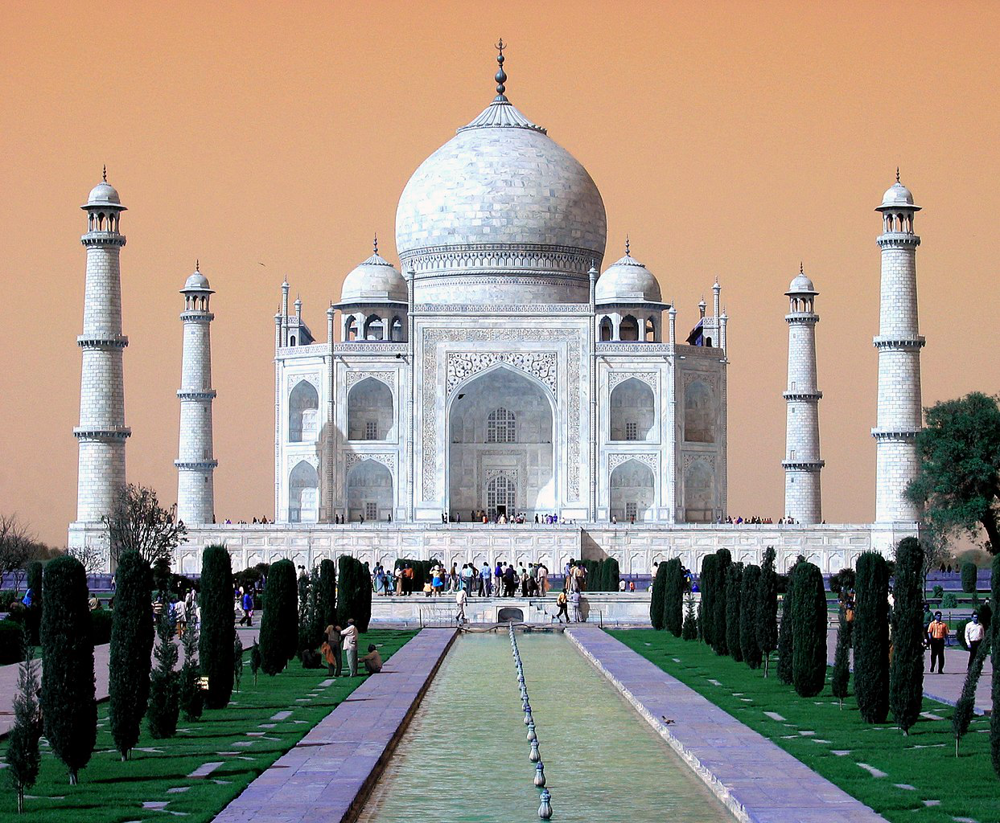

In [85]:
from google.colab.patches import cv2_imshow
from skimage import io
import cv2
import numpy as np 
url = 'https://upload.wikimedia.org/wikipedia/commons/thumb/c/c8/Taj_Mahal_in_March_2004.jpg/1243px-Taj_Mahal_in_March_2004.jpg'
ori = io.imread(url)
cv2_imshow(ori) 
image = io.imread(url)
gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)
dst = cv2.cornerHarris(gray,2,3,0.04)
dst = cv2.dilate(dst,None)
image[dst>0.01*dst.max()]=[0,0,255]

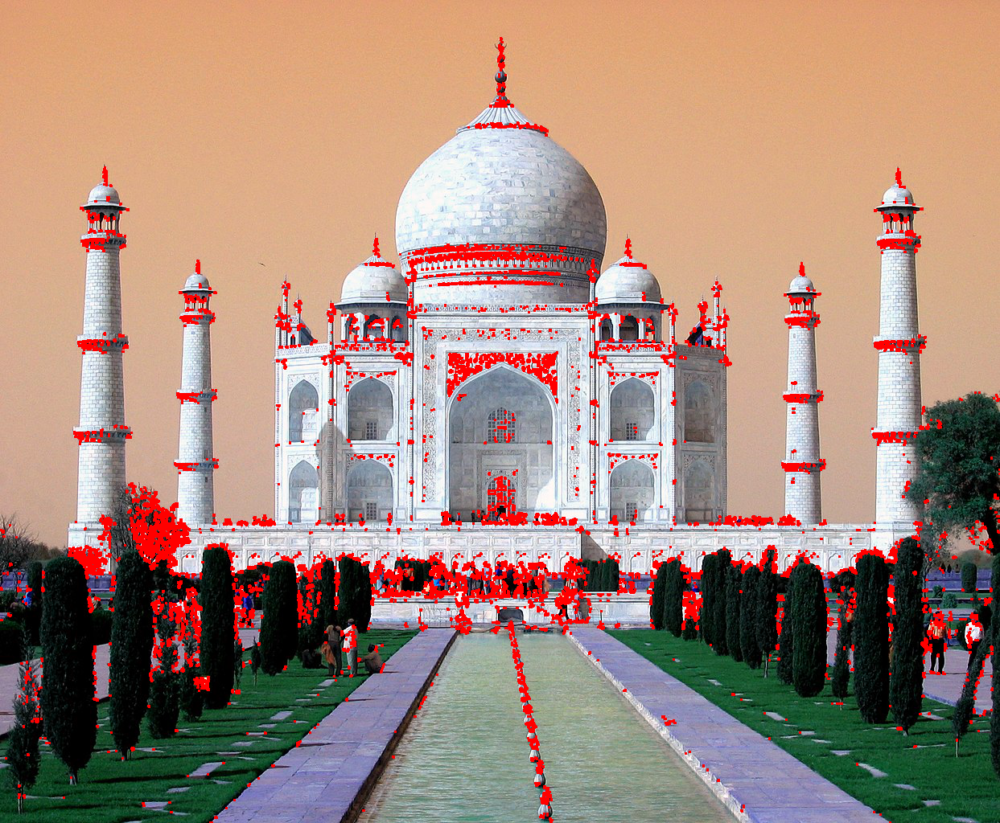

In [86]:
cv2_imshow(image)

**BLOB stands for Binary Large Object.**
It refers to a group of connected pixels or regions in a particular binary image that shares a common property. These regions are contours in OpenCV with some extra features like centroid, color, area, a mean, and standard deviation of the pixel values in the covered region. 

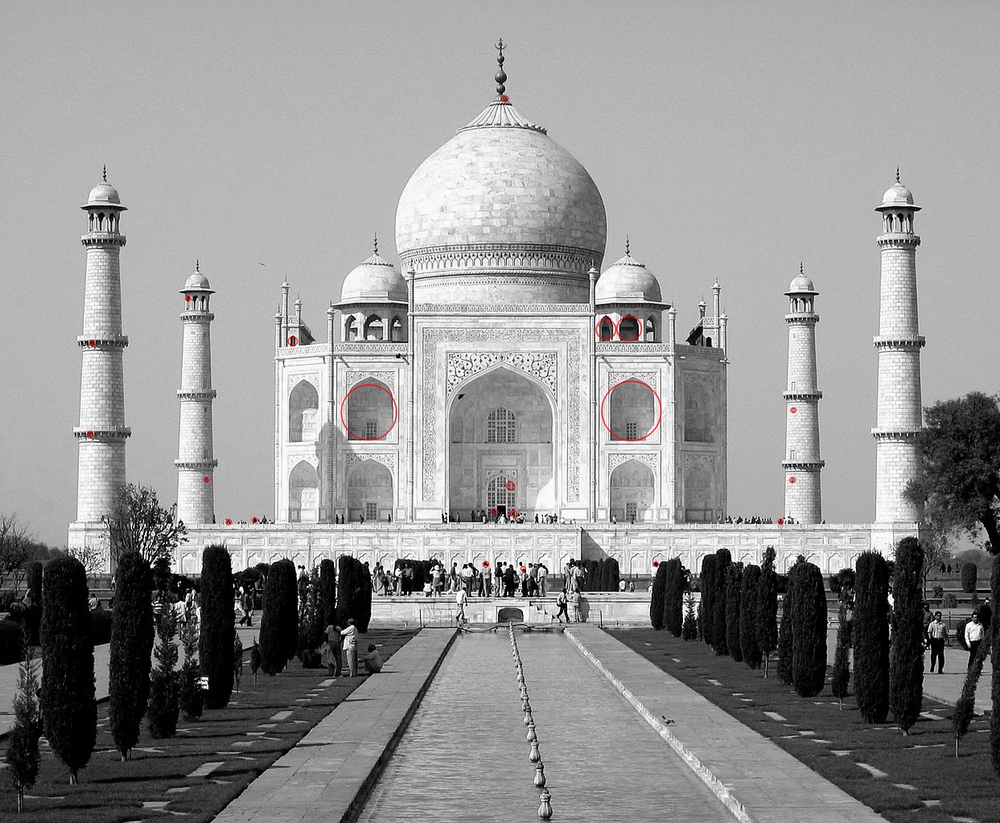

In [87]:

im = cv2.cvtColor(ori,cv2.COLOR_BGR2GRAY)
detector = cv2.SimpleBlobDetector_create()
keypoints = detector.detect(im)
im_with_keypoints = cv2.drawKeypoints(im, keypoints, np.array([]), (0,0,255), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

cv2_imshow(im_with_keypoints)

# Step 1: Import libraries

In [88]:
#GENERAL

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.cm as mtpltcm
from mpl_toolkits.mplot3d import Axes3D
import random
import time

#PATH PROCESS

import os
import os.path
from pathlib import Path
import glob
from scipy.io import loadmat
import nibabel as nib
import csv
from astropy.visualization import astropy_mpl_style
from astropy.utils.data import get_pkg_data_filename
from astropy.io import fits
import astropy
from astropy import units as u 
import astropy.wcs as fitswcs
#from specutils import Spectrum1D, SpectralRegion
from astropy.cosmology import WMAP9 as Cosmology

#IMAGE PROCESS

from PIL import Image
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.preprocessing import image
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from scipy.ndimage.filters import convolve
from skimage import data, io, filters
import skimage.morphology as morph
import skimage.exposure as skie
import skimage
from skimage.morphology import convex_hull_image, erosion
from IPython import display
from scipy.ndimage import gaussian_filter
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.patches as patches

#SCALER & TRANSFORMATION

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from keras.utils.np_utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
import sklearn

#import pydub
from scipy.io.wavfile import read, write
import librosa
import librosa.display
import IPython
from IPython.display import Audio
import scipy
from scipy import signal
from scipy.fft import fftshift

#IGNORING WARNINGS

from warnings import filterwarnings

filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning) 
filterwarnings("ignore", category=UserWarning)
filterwarnings("ignore", category=RuntimeWarning)

# Step 2 Read data

In [89]:
from google.colab import drive
drive.mount('/content/gdrive')
!unzip /content/gdrive/MyDrive/GALAXIES_CENTER.zip

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
Archive:  /content/gdrive/MyDrive/GALAXIES_CENTER.zip
replace M100/ISO/csli23500615.fits? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M100/NEAR_INFRARED/idkv31030_drz.fits? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M100/OPTICAL/hst_05195_01_wfpc2_f702w_pc_drz.fits? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M100/XMM_Newton_Soft_Xray/P0106860201EPX0003COLIM8000.FTZ? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M100/XMM_OM_Optical/P0106860201OMX000USIMAGU000.FTZ? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M101/ISO/csli26902583.fits? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M101/NEAR_INFRARED/hst_11080_a6_nic_nic3_f187n_drz.fits? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M101/OPTICAL/hst_13361_03_wfc3_uvis_f502n_drz.fits? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace M101/XMM_Newton_Soft_Xray/P0164560701EPX0003COLIM8000.FT

In [90]:
NEAR_INFRARED_PATH = "/content/NGC6946/NEAR_INFRARED/n4k48nbsq_cal.fits"
HST_OPTICAL_PATH = "/content/NGC6946/OPTICAL/HST/idk404050/idk404050_drc.fits"
XMM_NEWTON_PATH = "/content/NGC6946/XMM_NEWTON_Soft_Xray/P0200670301EPX0003COLIM8000.FTZ"
XMM_OM_PATH = "/content/NGC6946/XMM_OM_Optical/P0200670301OMX000LSIMAGB000.FTZ"
ISO_PATH = "/content/NGC6946/ISO/csp3390040401.fits"

# Step 3: open data

In [7]:
NI_OPEN = fits.open(NEAR_INFRARED_PATH)
HST_OPEN = fits.open(HST_OPTICAL_PATH)
XMM_NEWTON_OPEN = fits.open(XMM_NEWTON_PATH)
XMM_OM_OPEN = fits.open(XMM_OM_PATH)
ISO_OPEN = fits.open(ISO_PATH)

NI_SCI = NI_OPEN[1].data
HST_SCI = HST_OPEN[1].data
NEWTON_RAW = XMM_NEWTON_OPEN[1].data
OM_PRIMARY = XMM_OM_OPEN[0].data
ISO_PRIMARY = ISO_OPEN[0].data

# Step 4: Read specific section of data

In [8]:
WIDE_SCALE_NI = NI_SCI[90:,60:220]
ZOOMED_SCALE_NI = NI_SCI[150:,95:195]
NUCLEUS_SCALE_NI = NI_SCI[190:220,120:165]

WIDE_SCALE_HST = HST_SCI[700:4000,700:4000]
ZOOMED_SCALE_HST = HST_SCI[1800:3400,1700:3200]
ZOOMED_X2_SCALE_HST = HST_SCI[2100:3100,2000:3000]
ZOOMED_X3_SCALE_HST = HST_SCI[2450:2850,2300:2700]
NUCLEUS_SCALE_HST = HST_SCI[2640:2850,2330:2650]

WIDE_SCALE_NEWTON = NEWTON_RAW[2][155:480,160:440]
ZOOMED_SCALE_NEWTON = NEWTON_RAW[2][200:400,200:380]
NUCLEUS_SCALE_NEWTON = NEWTON_RAW[2][270:370,240:340]

WIDE_SCALE_OM = OM_PRIMARY[480:1070,350:1195]
ZOOMED_SCALE_OM = OM_PRIMARY[370:1055,420:1070]
NUCLEUS_SCALE_OM = OM_PRIMARY[500:950,500:950]

ISO_CONS_SCALE = ISO_PRIMARY[1][:,7:22]

In [9]:
SPECTRAL_LIST = ["gray","jet","hot","prism","nipy_spectral",
             "gist_ncar","gist_earth","gist_stern","flag","gnuplot2",'terrain']

# Step 5: Find features

In [10]:
FCF_WIDE_SCALE_NI = skimage.feature.corner_foerstner(WIDE_SCALE_NI)
FCF_ZOOMED_SCALE_NI = skimage.feature.corner_foerstner(ZOOMED_SCALE_NI)
FCF_NUCLEUS_SCALE_NI = skimage.feature.corner_foerstner(NUCLEUS_SCALE_NI)

FCF_WIDE_SCALE_HST = skimage.feature.corner_foerstner(WIDE_SCALE_HST)
FCF_ZOOMED_SCALE_HST = skimage.feature.corner_foerstner(ZOOMED_SCALE_HST)
FCF_ZOOMED_X2_SCALE_HST = skimage.feature.corner_foerstner(ZOOMED_X2_SCALE_HST)
FCF_ZOOMED_X3_SCALE_HST = skimage.feature.corner_foerstner(ZOOMED_X3_SCALE_HST)
FCF_NUCLEUS_SCALE_HST = skimage.feature.corner_foerstner(NUCLEUS_SCALE_HST)

FCF_WIDE_SCALE_NEWTON = skimage.feature.corner_foerstner(WIDE_SCALE_NEWTON)
FCF_ZOOMED_SCALE_NEWTON = skimage.feature.corner_foerstner(ZOOMED_SCALE_NEWTON)
FCF_NUCLEUS_SCALE_NEWTON = skimage.feature.corner_foerstner(NUCLEUS_SCALE_NEWTON)

FCF_WIDE_SCALE_OM = skimage.feature.corner_foerstner(WIDE_SCALE_OM)
FCF_ZOOMED_SCALE_OM = skimage.feature.corner_foerstner(ZOOMED_SCALE_OM)
FCF_NUCLEUS_SCALE_OM = skimage.feature.corner_foerstner(NUCLEUS_SCALE_OM)

FCF_ISO_CONS_SCALE = skimage.feature.corner_foerstner(ISO_CONS_SCALE)

# Step 6: Display

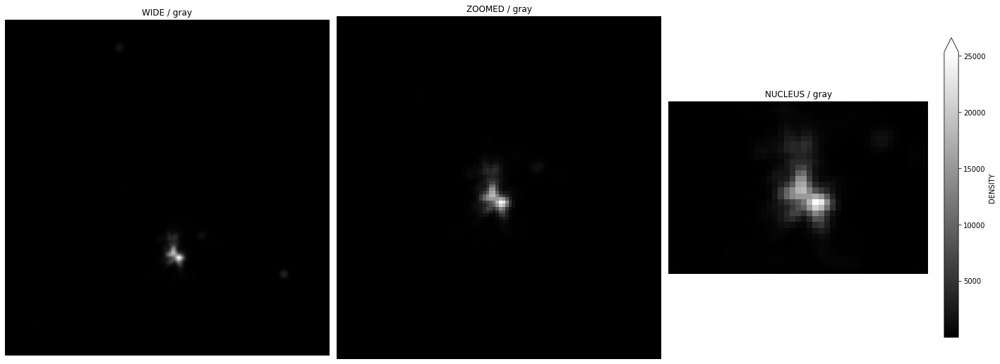

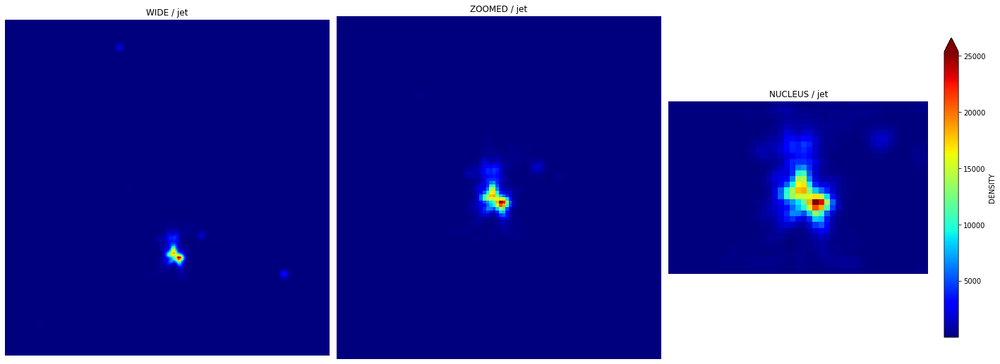

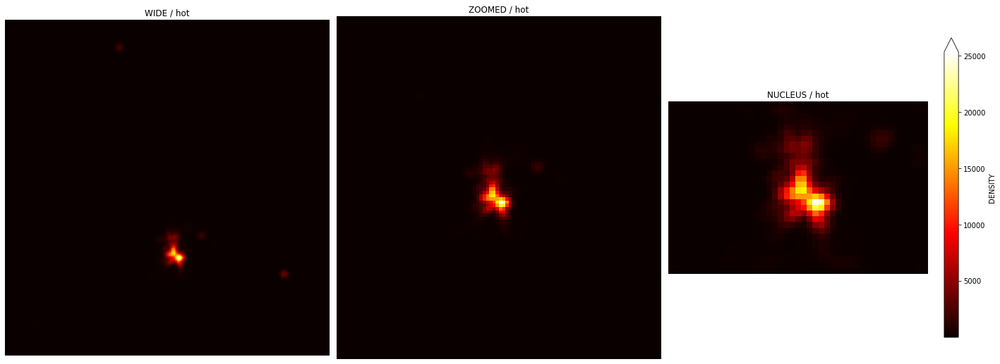

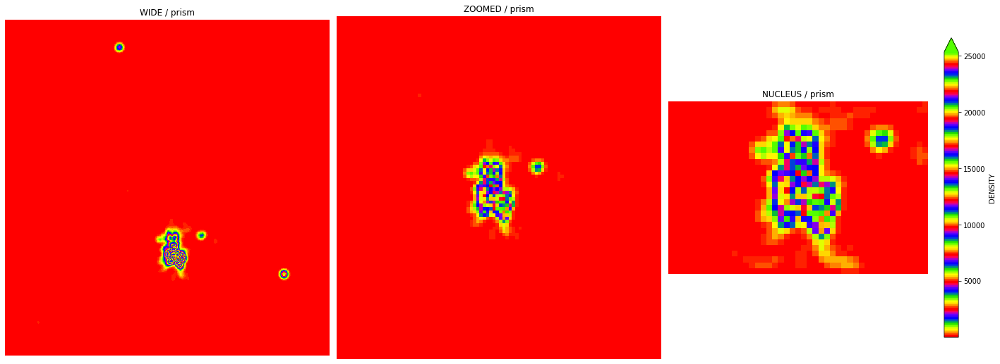

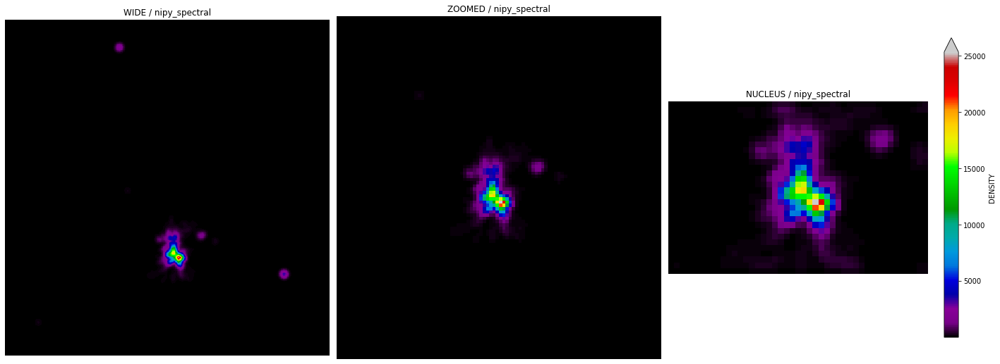

...

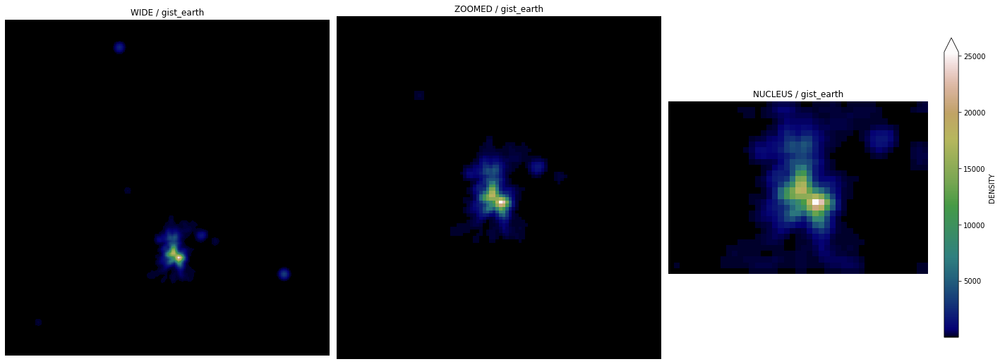

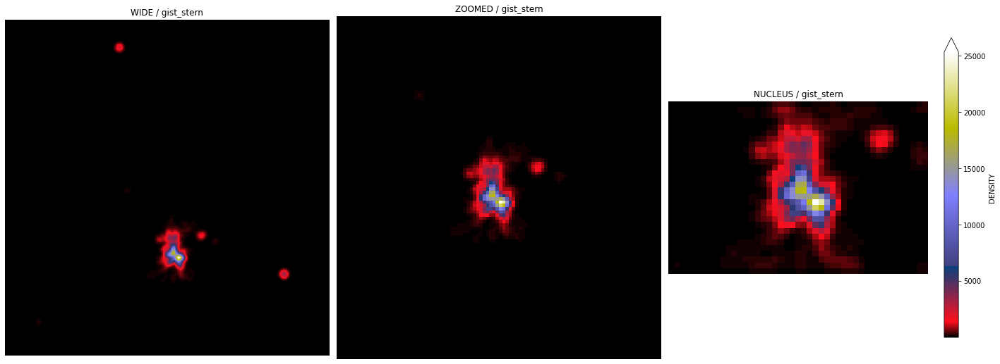

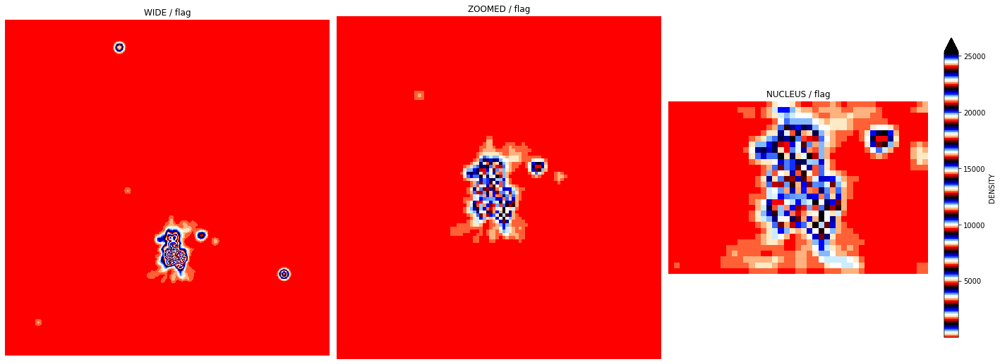

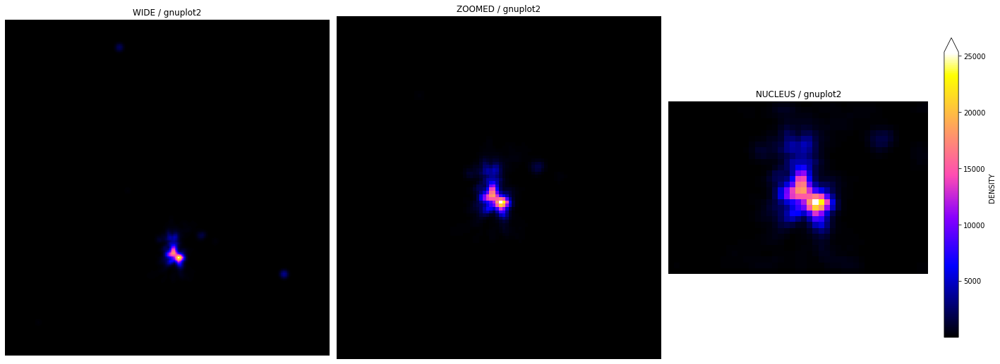

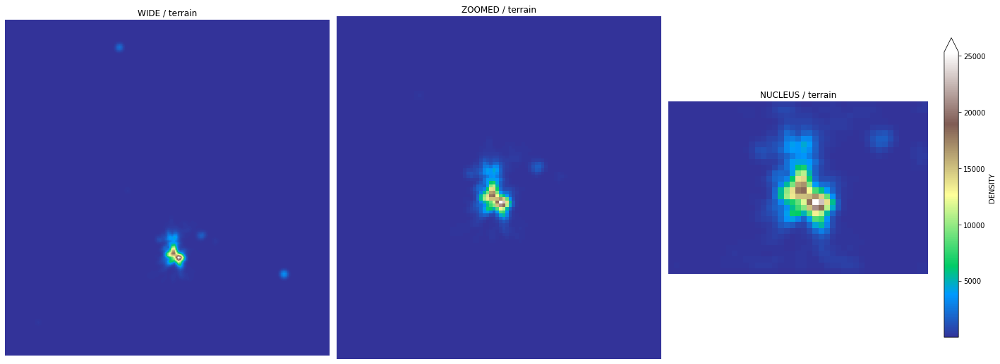

In [11]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,3,figsize=(20,20))
    
    axis[0].imshow(FCF_WIDE_SCALE_NI[0],cmap=x_spec)
    axis[0].set_title("WIDE" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(FCF_ZOOMED_SCALE_NI[0],cmap=x_spec)
    axis[1].set_title("ZOOMED" + " / "+ x_spec)
    axis[1].axis("off")
    
    DENSITY_FUNC = axis[2].imshow(FCF_NUCLEUS_SCALE_NI[0],cmap=x_spec)
    axis[2].set_title("NUCLEUS" + " / "+ x_spec)
    axis[2].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

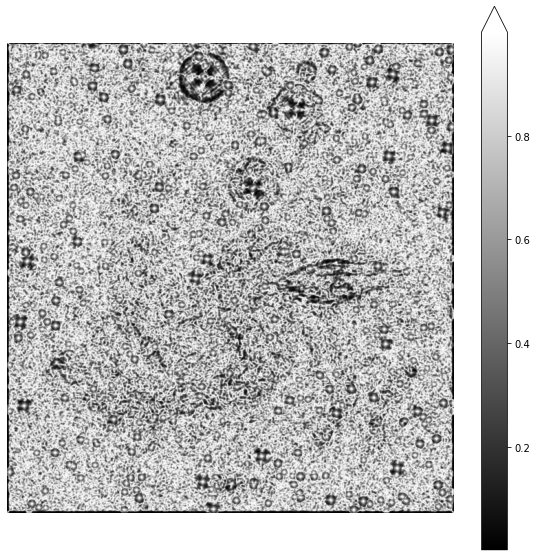

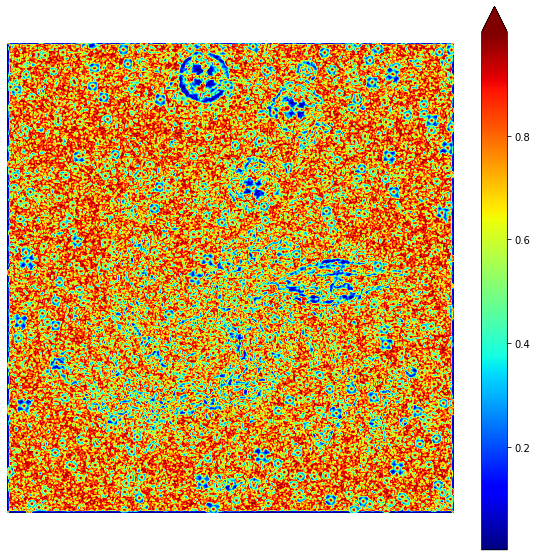

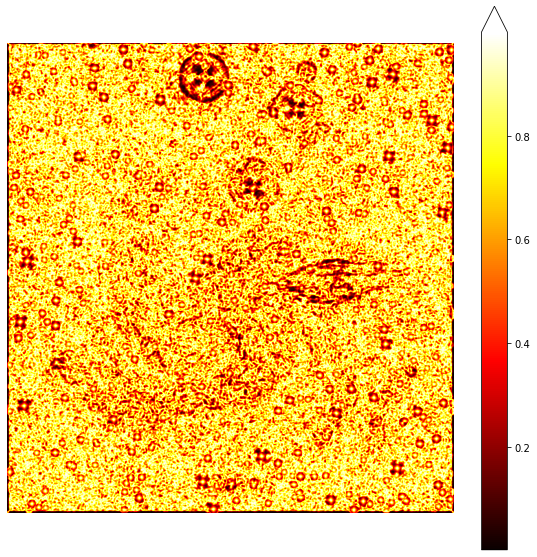

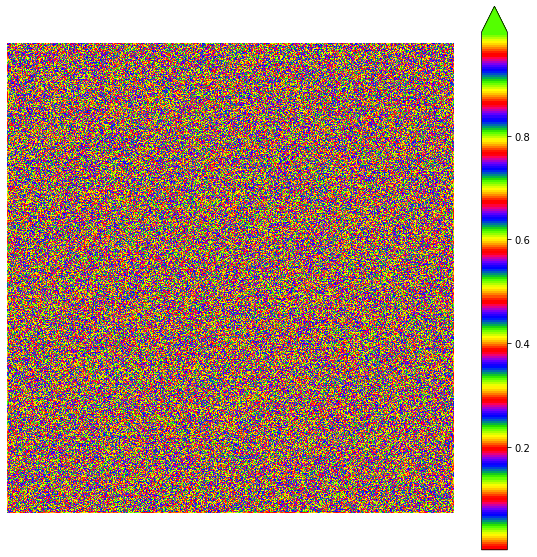

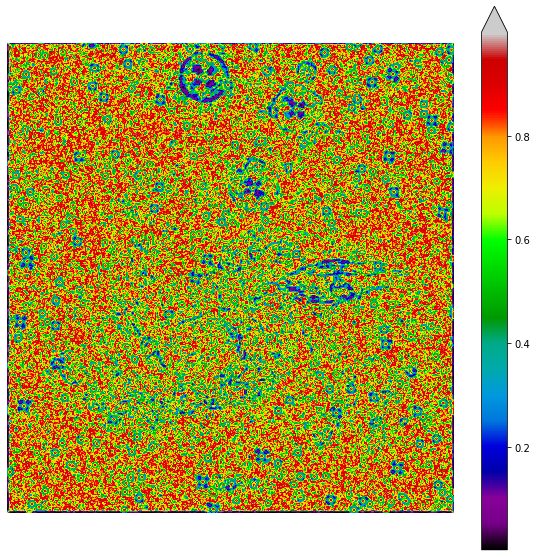

...

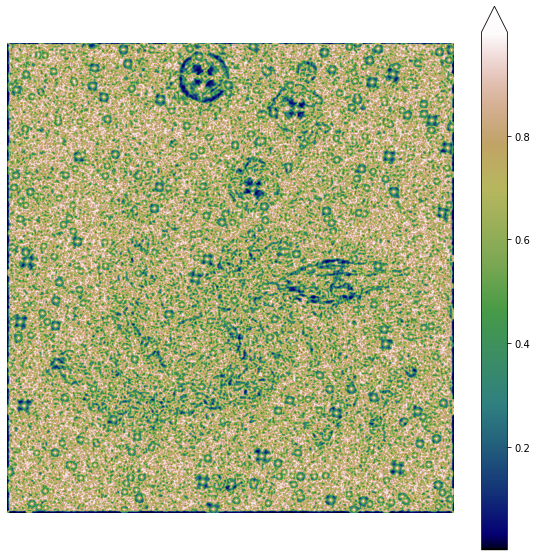

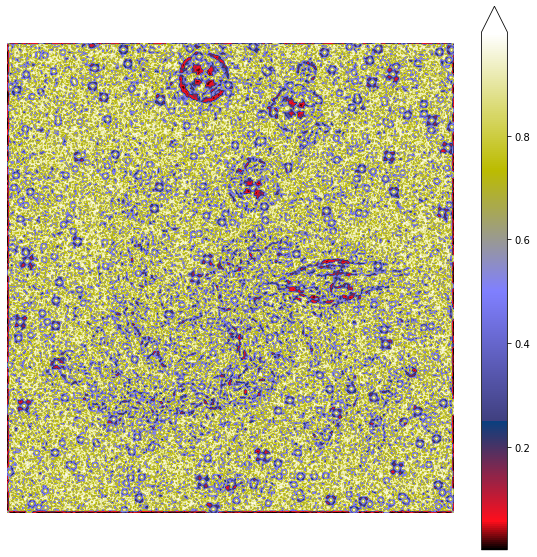

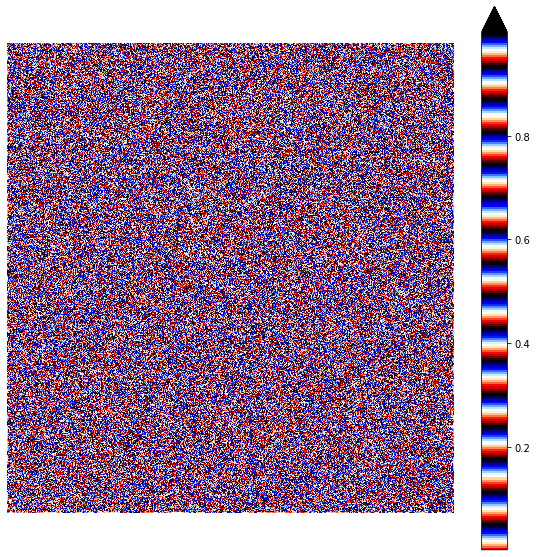

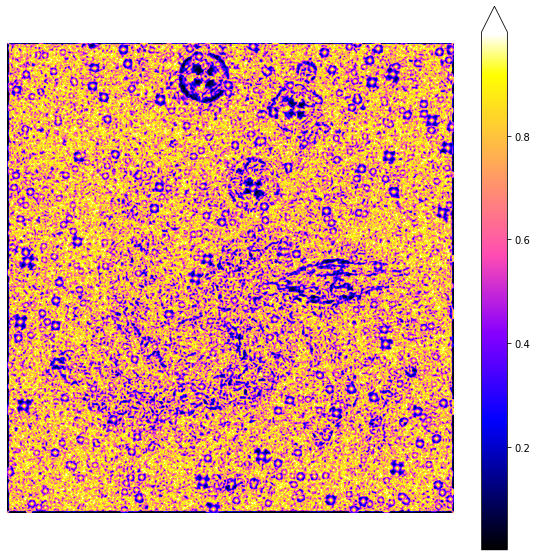

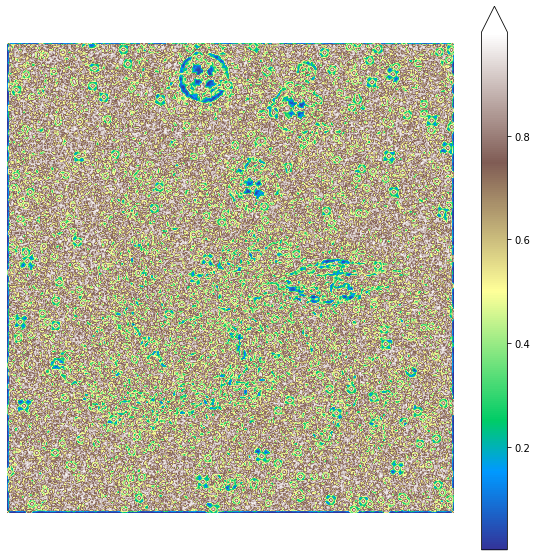

In [19]:
for x_spec in SPECTRAL_LIST:
    
    figure = plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(FCF_ZOOMED_SCALE_OM[1],cmap=x_spec)
    plt.colorbar(extend="max")
    plt.show()

In [20]:
TARGET_LIST = [ZOOMED_SCALE_NEWTON, ZOOMED_SCALE_OM]

In [22]:
figure = plt.figure(figsize=(12,12))

Picking_Image=ZOOMED_SCALE_OM
Dark_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 0.05

<Figure size 864x864 with 0 Axes>

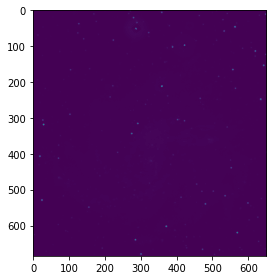

In [23]:
plt.imshow(Dark_IMG)
plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


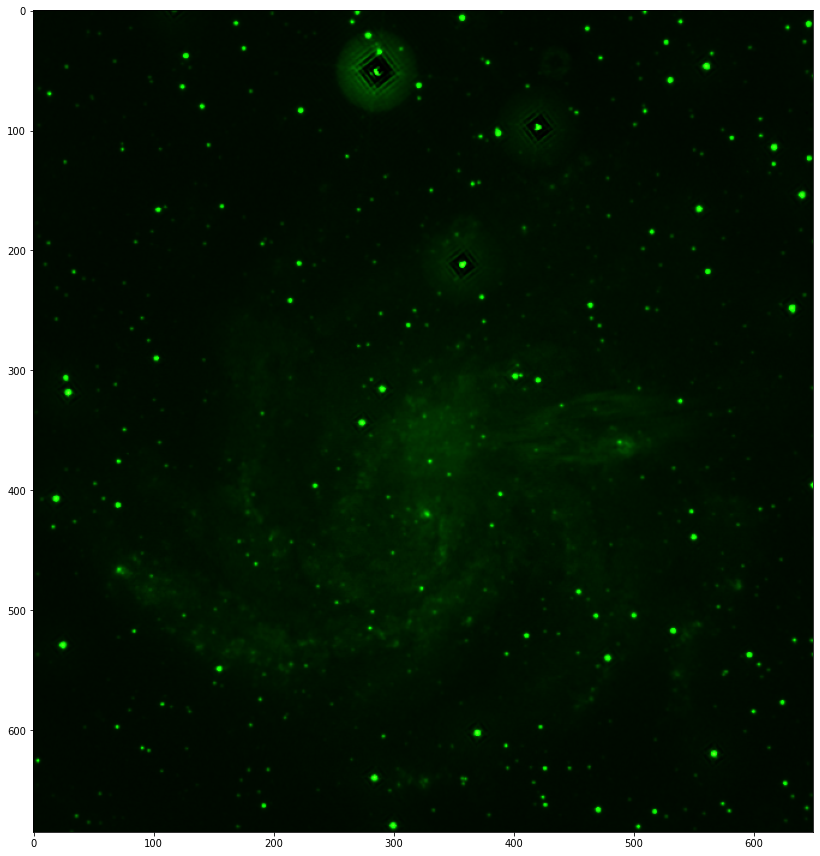

In [25]:
figure = plt.figure(figsize=(12,12))
Picking_Image = ZOOMED_SCALE_OM
Spes_Color_IMG = np.dstack((Picking_Image*0.05, Picking_Image*1.5, Picking_Image*0.02))
plt.imshow(Spes_Color_IMG)
plt.tight_layout()
plt.show()

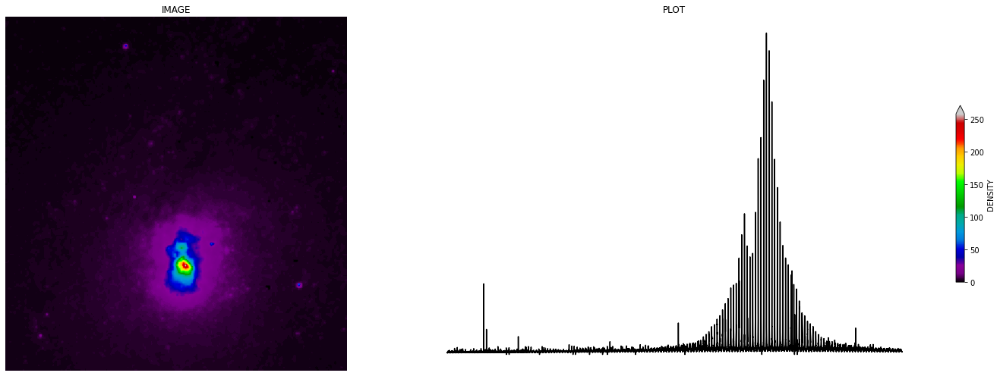

In [26]:
figure,axis = plt.subplots(1,2,figsize=(22,7))
    
DENSITY_FUNC = axis[0].imshow(WIDE_SCALE_NI,cmap="nipy_spectral")
axis[0].set_title("IMAGE")
axis[0].axis("off")
    
axis[1].plot(WIDE_SCALE_NI.flatten(),color="black")
axis[1].set_title("PLOT")
axis[1].axis("off")
    
figure.colorbar(DENSITY_FUNC,shrink=0.5,label="DENSITY",extend="max")
plt.tight_layout()
plt.show()

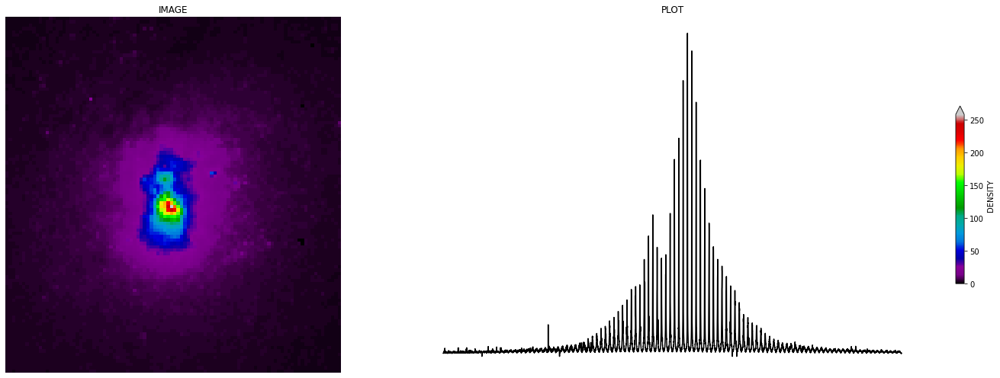

In [27]:
figure,axis = plt.subplots(1,2,figsize=(22,7))
    
DENSITY_FUNC = axis[0].imshow(ZOOMED_SCALE_NI,cmap="nipy_spectral")
axis[0].set_title("IMAGE")
axis[0].axis("off")
    
axis[1].plot(ZOOMED_SCALE_NI.flatten(),color="black")
axis[1].set_title("PLOT")
axis[1].axis("off")
    
figure.colorbar(DENSITY_FUNC,shrink=0.5,label="DENSITY",extend="max")
plt.tight_layout()
plt.show()

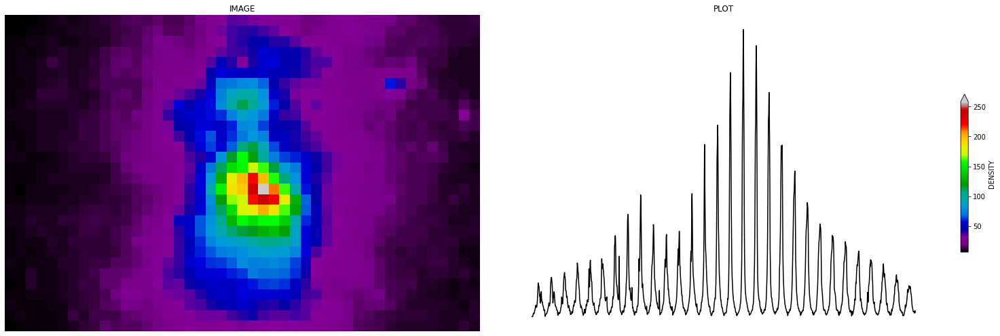

In [28]:
figure,axis = plt.subplots(1,2,figsize=(22,7))
    
DENSITY_FUNC = axis[0].imshow(NUCLEUS_SCALE_NI,cmap="nipy_spectral")
axis[0].set_title("IMAGE")
axis[0].axis("off")
    
axis[1].plot(NUCLEUS_SCALE_NI.flatten(),color="black")
axis[1].set_title("PLOT")
axis[1].axis("off")
    
figure.colorbar(DENSITY_FUNC,shrink=0.5,label="DENSITY",extend="max")
plt.tight_layout()
plt.show()

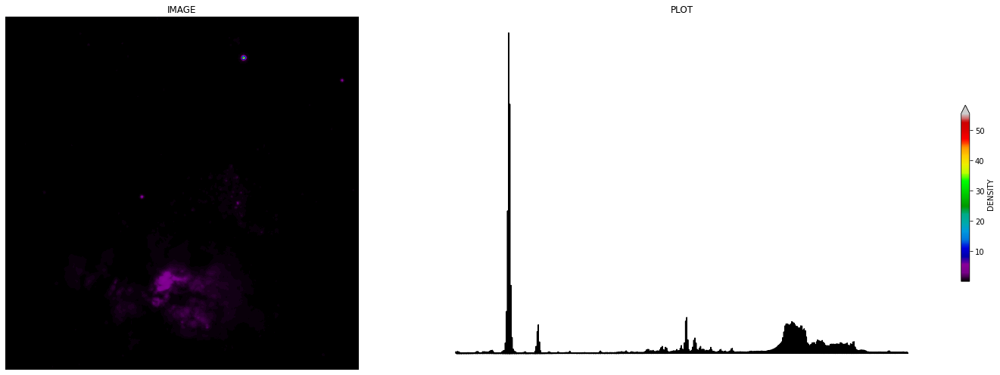

In [32]:
figure,axis = plt.subplots(1,2,figsize=(22,7))
    
DENSITY_FUNC = axis[0].imshow(ZOOMED_X3_SCALE_HST,cmap="nipy_spectral")
axis[0].set_title("IMAGE")
axis[0].axis("off")
    
axis[1].plot(ZOOMED_X3_SCALE_HST.flatten(),color="black")
axis[1].set_title("PLOT")
axis[1].axis("off")
    
figure.colorbar(DENSITY_FUNC,shrink=0.5,label="DENSITY",extend="max")
plt.tight_layout()
plt.show()

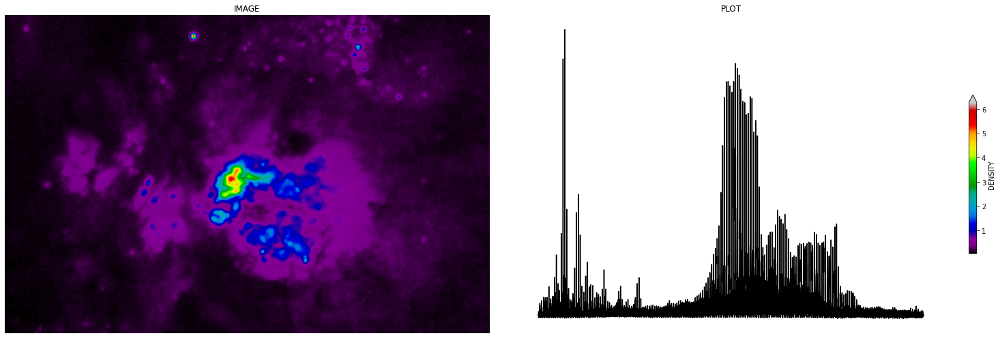

In [33]:
figure,axis = plt.subplots(1,2,figsize=(22,7))
    
DENSITY_FUNC = axis[0].imshow(NUCLEUS_SCALE_HST,cmap="nipy_spectral")
axis[0].set_title("IMAGE")
axis[0].axis("off")
    
axis[1].plot(NUCLEUS_SCALE_HST.flatten(),color="black")
axis[1].set_title("PLOT")
axis[1].axis("off")
    
figure.colorbar(DENSITY_FUNC,shrink=0.5,label="DENSITY",extend="max")
plt.tight_layout()
plt.show()

In [41]:
SATO_ZOOMED_X3_SCALE_HST = filters.sato(ZOOMED_X3_SCALE_HST)
SATO_NUCLEUS_SCALE_HST = filters.sato(NUCLEUS_SCALE_HST)

In [42]:
M_ZOOMED_X3_SCALE_HST = filters.meijering(ZOOMED_X3_SCALE_HST)
M_NUCLEUS_SCALE_HST = filters.meijering(NUCLEUS_SCALE_HST)

In [43]:
BM_ZOOMED_X3_SCALE_HST = filters.meijering(ZOOMED_X3_SCALE_HST,black_ridges=False)
BM_NUCLEUS_SCALE_HST = filters.meijering(NUCLEUS_SCALE_HST,black_ridges=False)

In [44]:
R_ZOOMED_X3_SCALE_HST = filters.roberts_neg_diag(ZOOMED_X3_SCALE_HST)
R_NUCLEUS_SCALE_HST = filters.roberts_neg_diag(NUCLEUS_SCALE_HST)

In [45]:
FCF_ZOOMED_X3_SCALE_HST = skimage.feature.corner_foerstner(ZOOMED_X3_SCALE_HST)
FCF_NUCLEUS_SCALE_HST = skimage.feature.corner_foerstner(NUCLEUS_SCALE_HST)

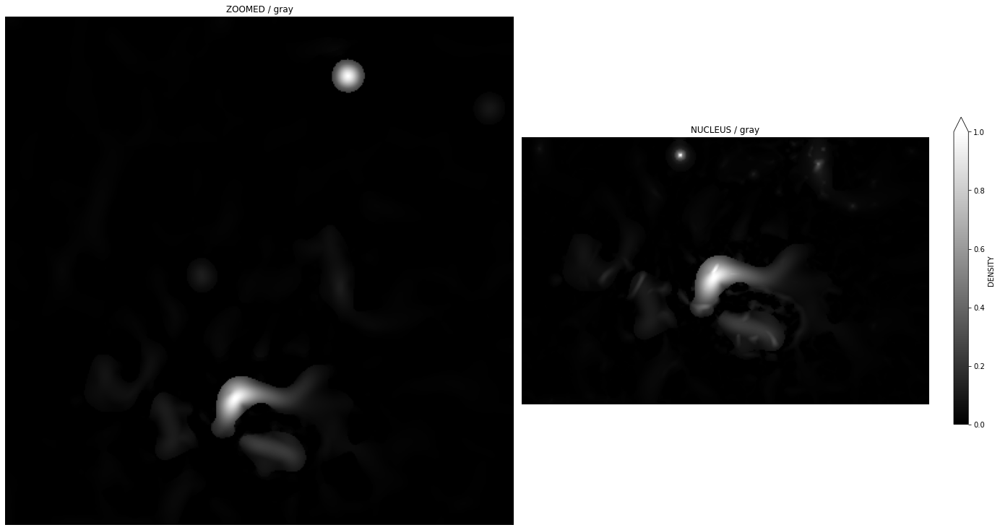

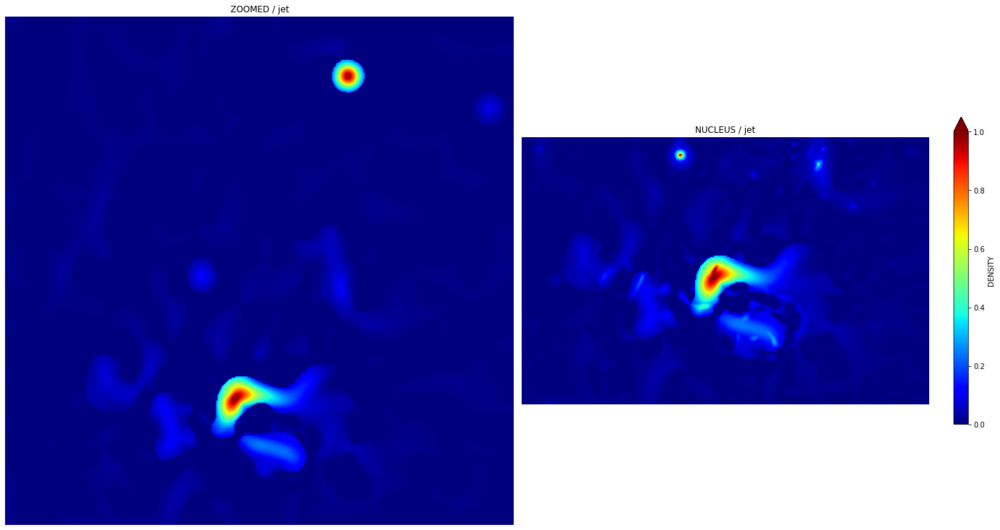

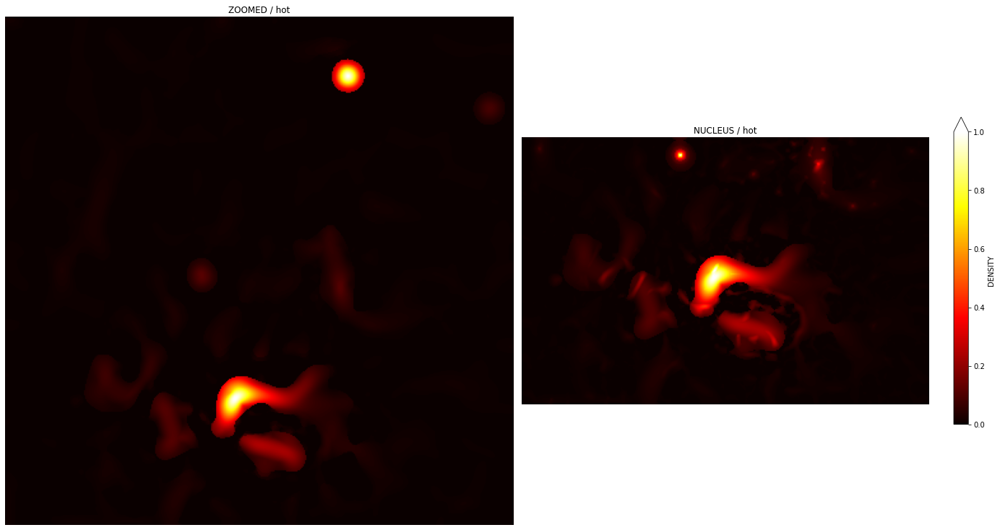

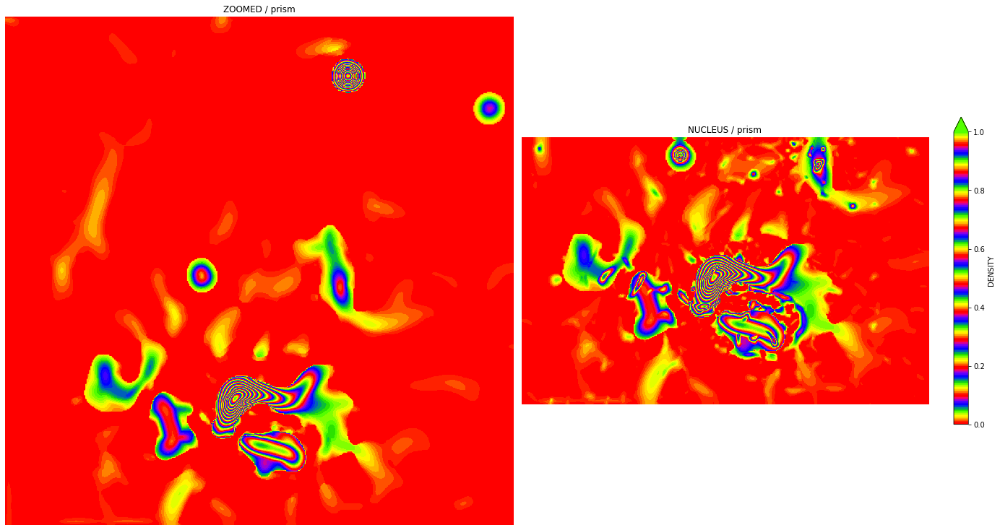

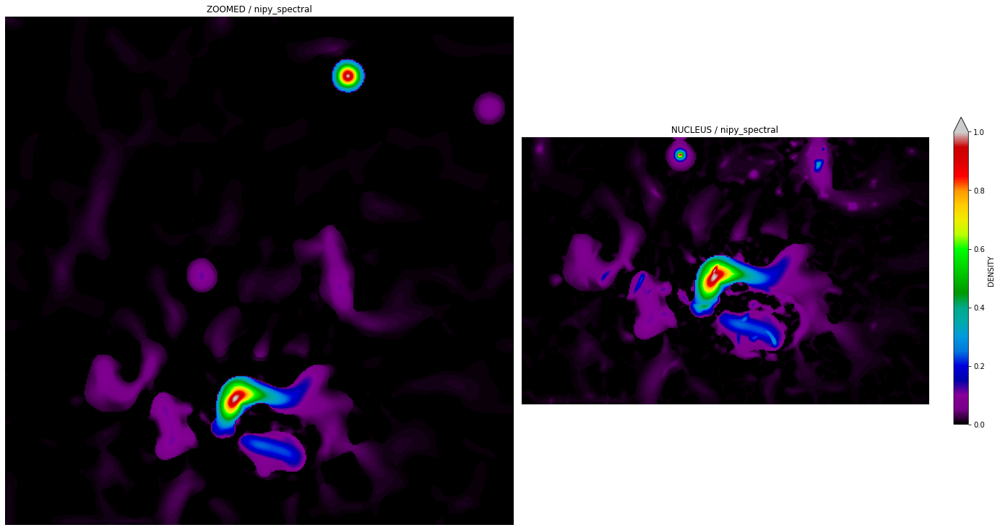

...

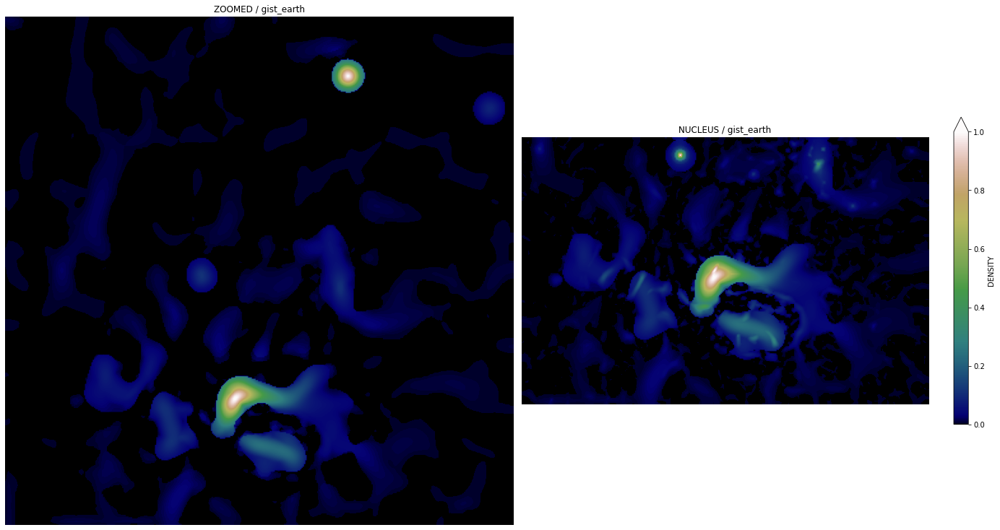

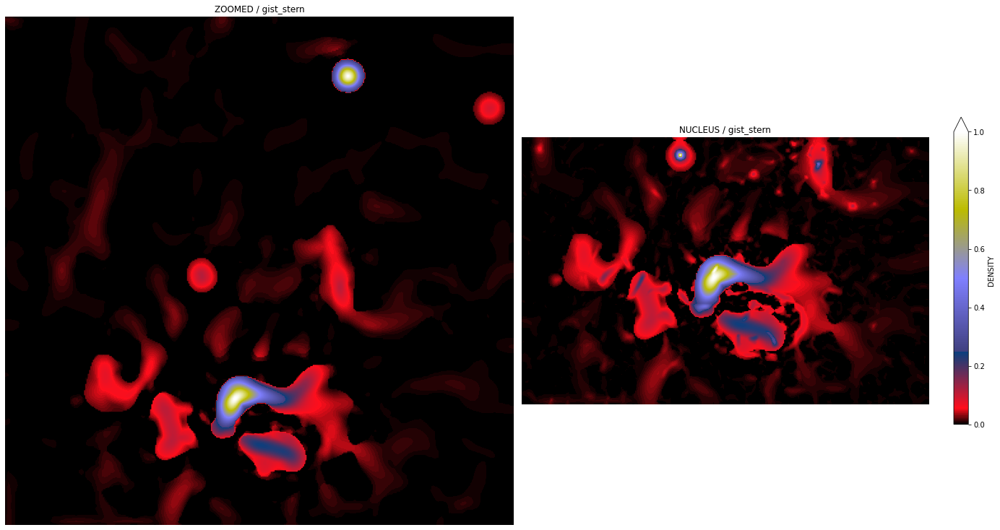

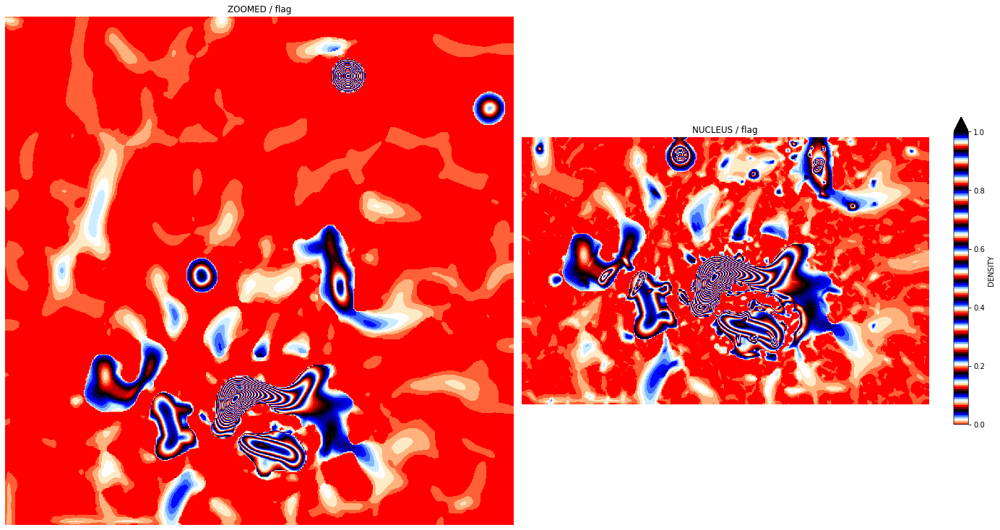

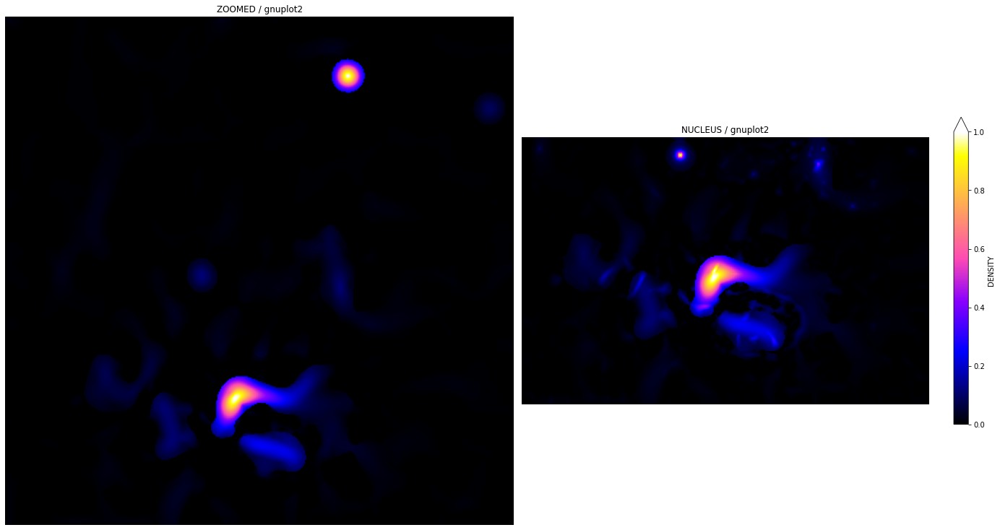

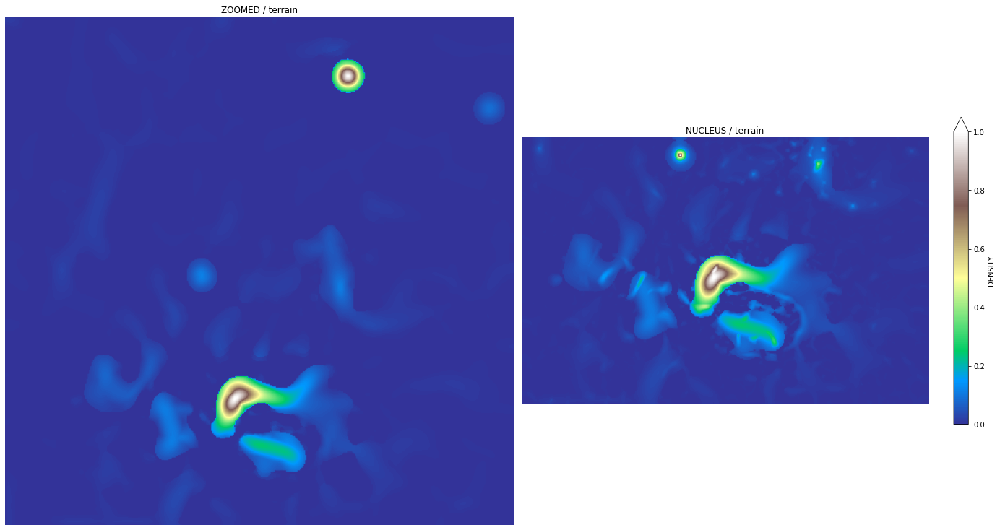

In [48]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(BM_ZOOMED_X3_SCALE_HST,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(BM_NUCLEUS_SCALE_HST,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

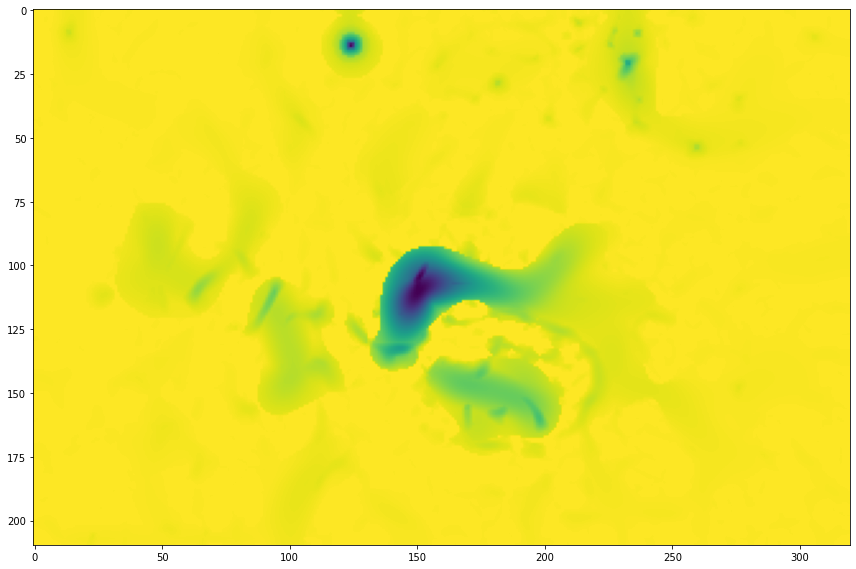

In [52]:
figure = plt.figure(figsize=(12,12))
Picking_Image = BM_NUCLEUS_SCALE_HST
Bright_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 1000
plt.imshow(Bright_IMG)
plt.tight_layout()
plt.show()

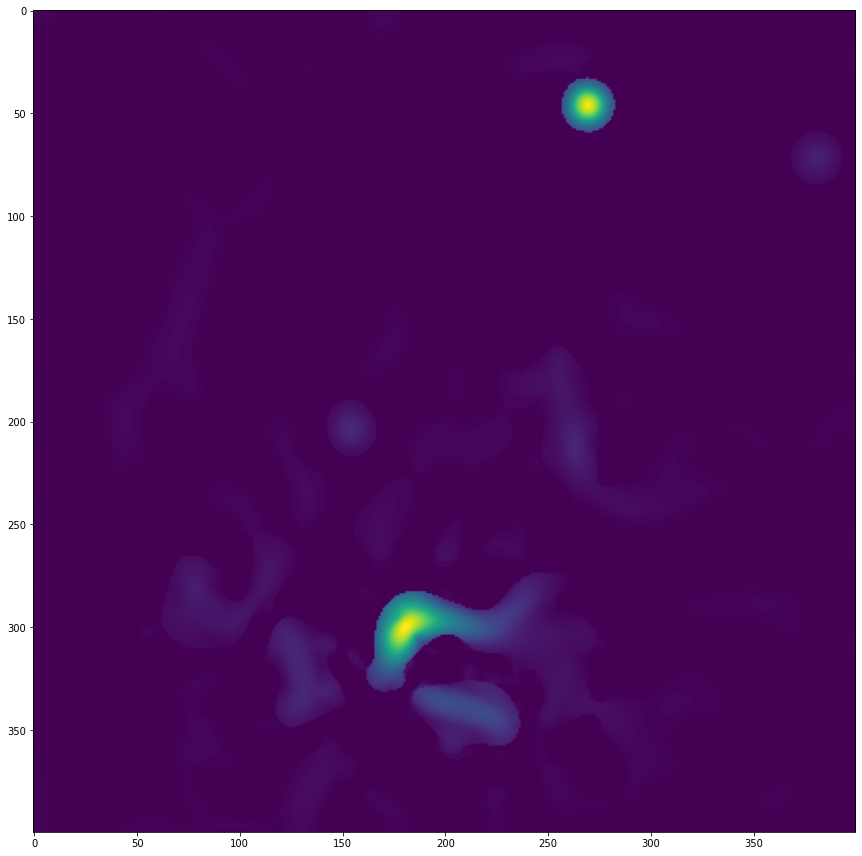

In [53]:
figure = plt.figure(figsize=(12,12))
Picking_Image = BM_ZOOMED_X3_SCALE_HST
Dark_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 0.05
plt.imshow(Dark_IMG)
plt.tight_layout()
plt.show()

In [57]:
HST_OPEN[0].header["RA_TARG"] 

308.714475

In [58]:
HST_OPEN[0].header["DEC_TARG"]

60.15866944444

Applying gaussian filter

In [59]:
GAUSS_ZOOMED_X2 = gaussian_filter(ZOOMED_X3_SCALE_HST,sigma=7)
GAUSS_NUCLEUS = gaussian_filter(NUCLEUS_SCALE_HST,sigma=7)

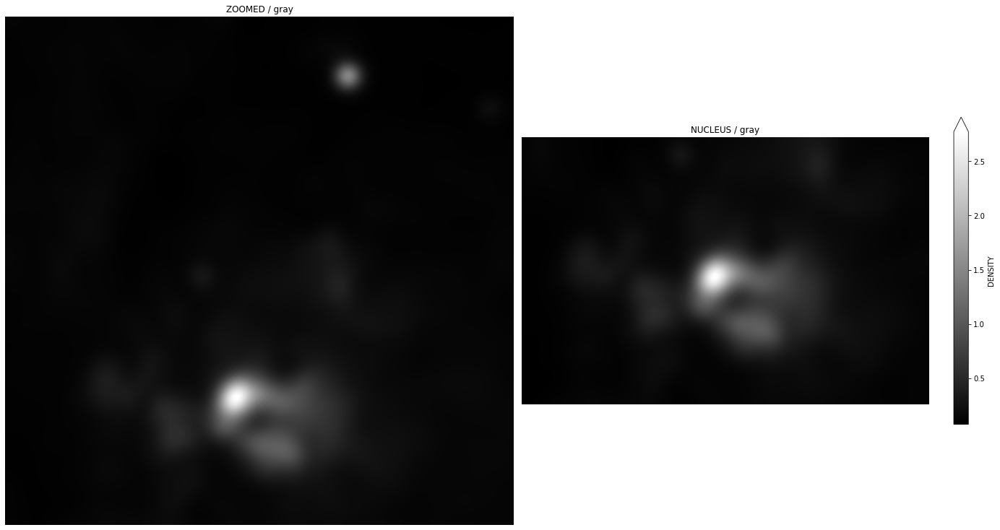

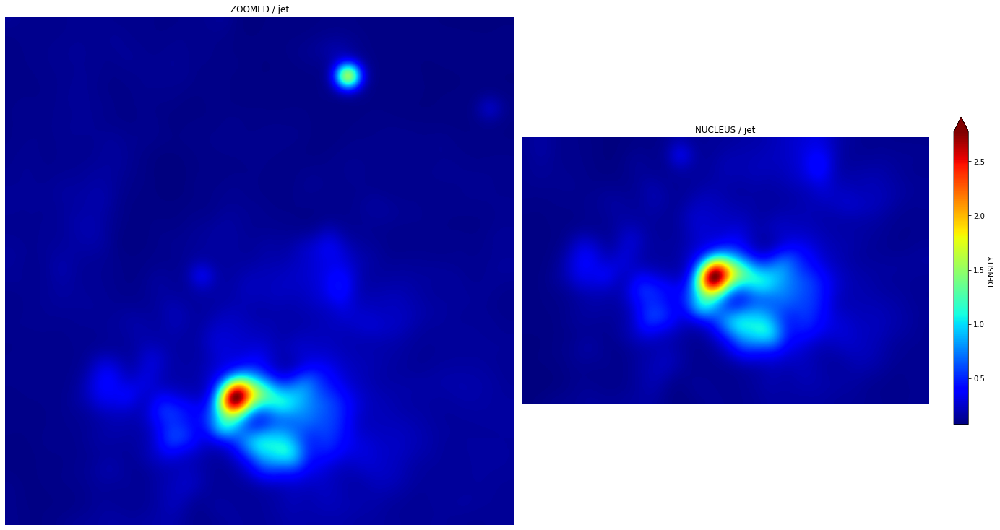

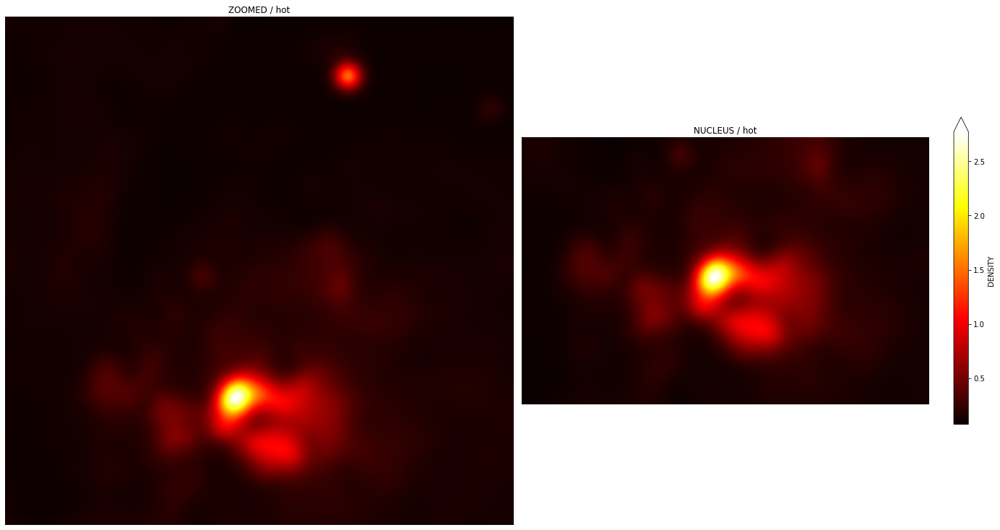

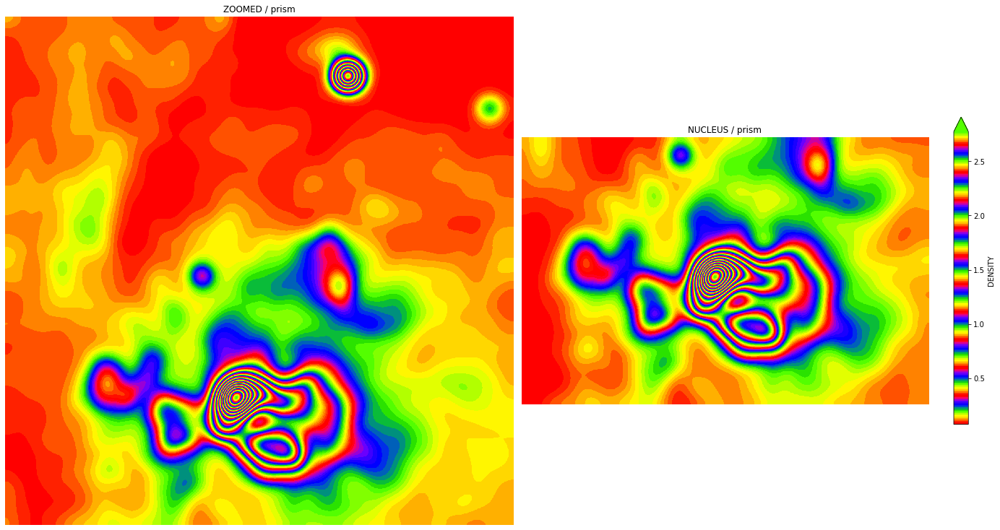

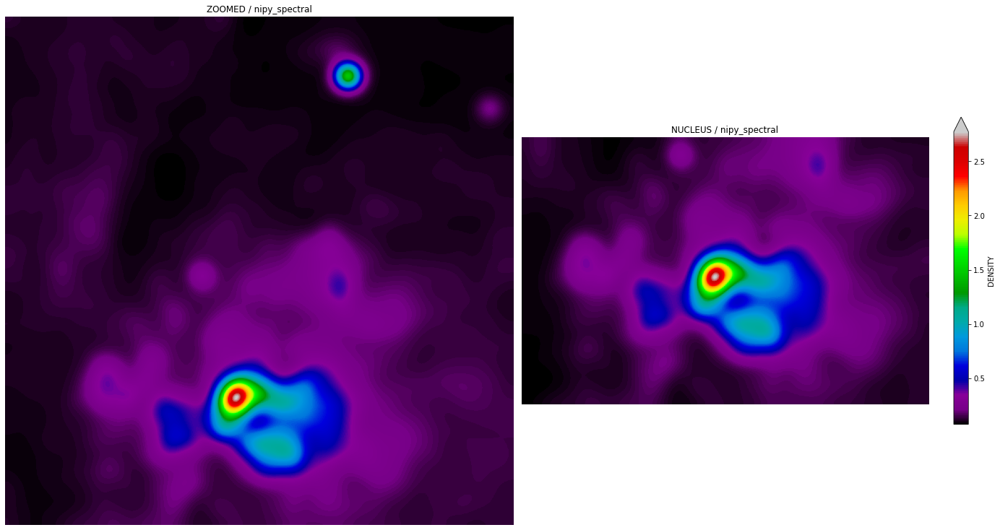

...

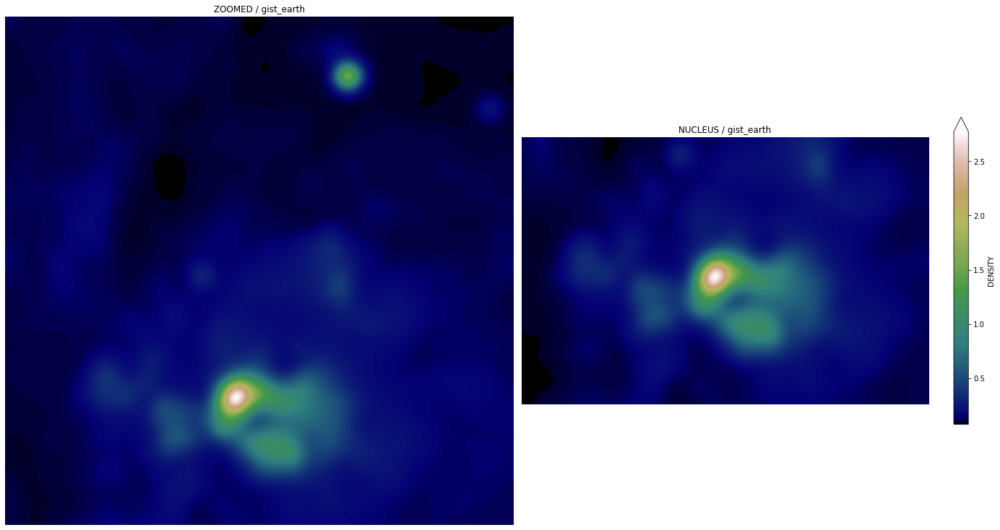

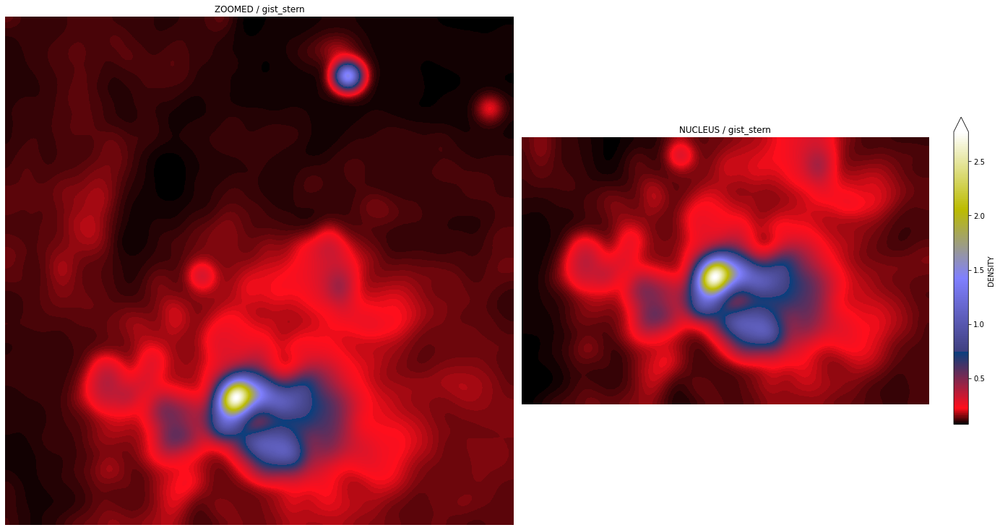

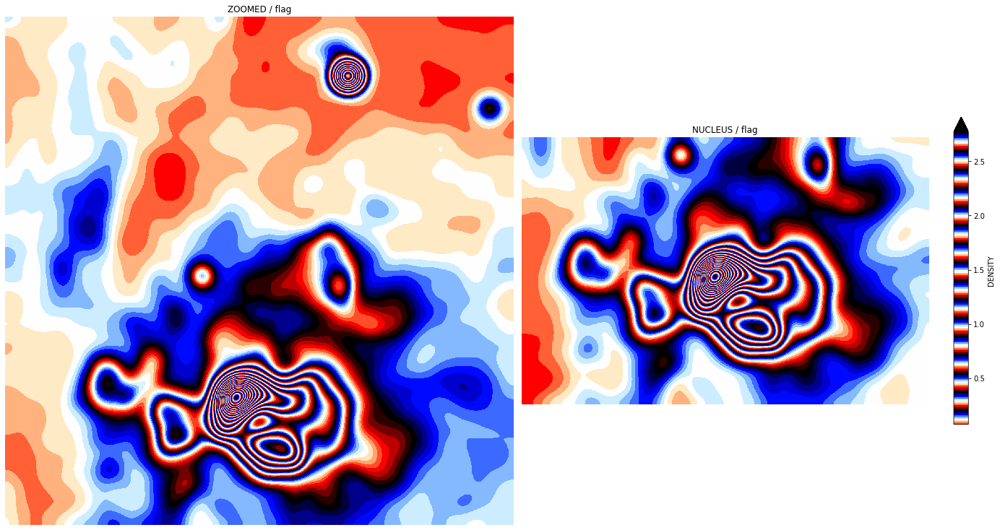

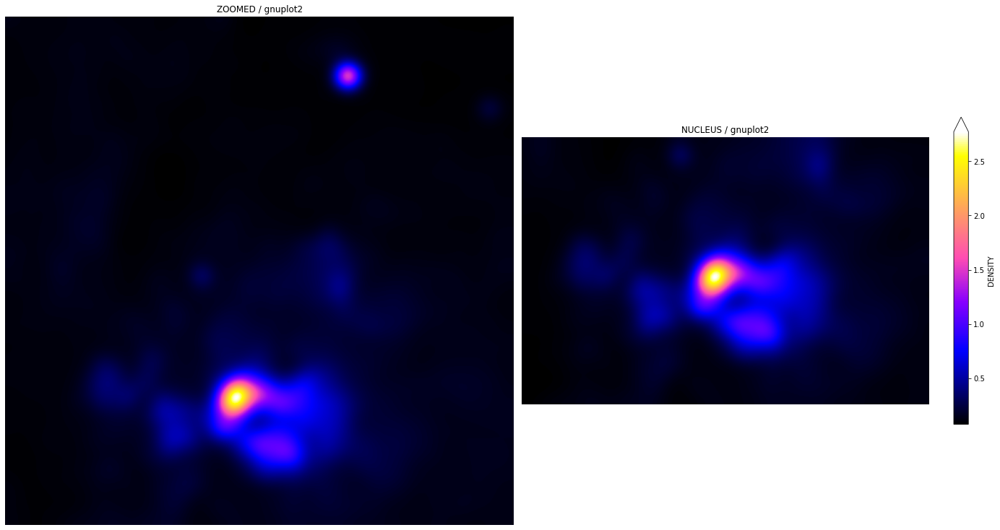

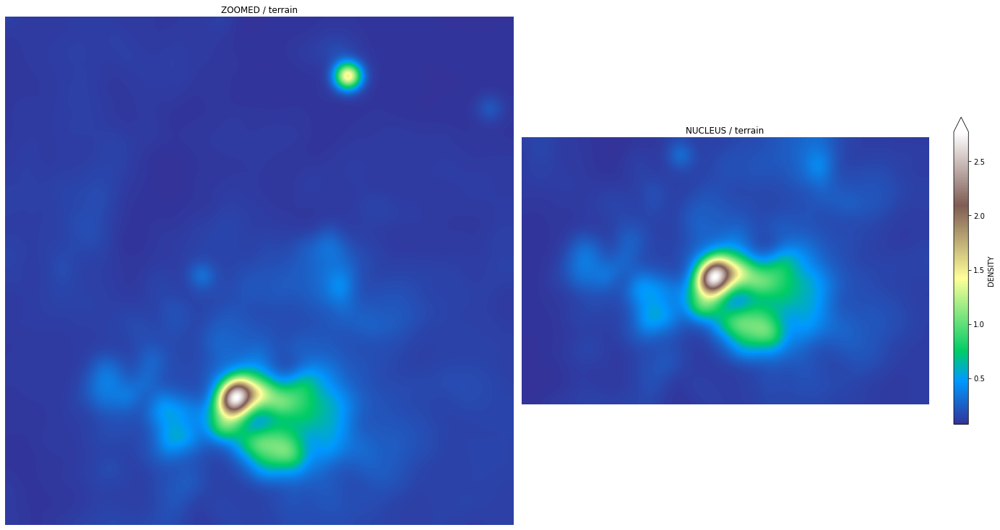

In [60]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(GAUSS_ZOOMED_X2,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(GAUSS_NUCLEUS,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

In [61]:
M_GAUSS_ZOOMED_X2 = gaussian_filter(M_ZOOMED_X3_SCALE_HST,sigma=7)
M_GAUSS_NUCLEUS = gaussian_filter(M_NUCLEUS_SCALE_HST,sigma=7)

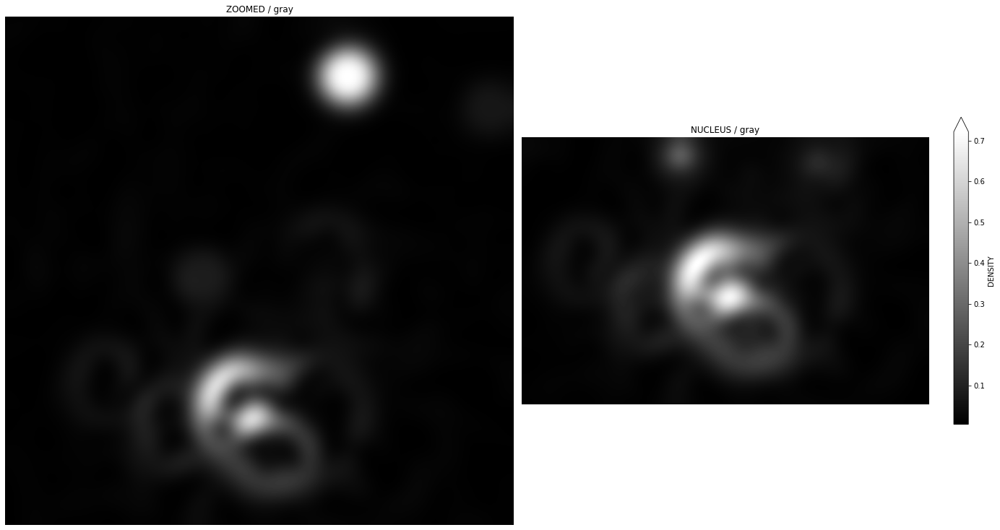

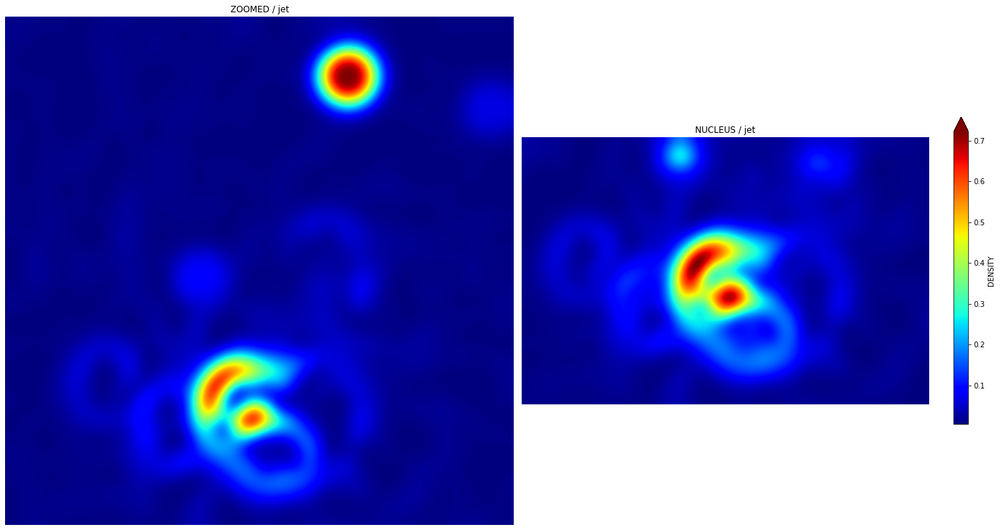

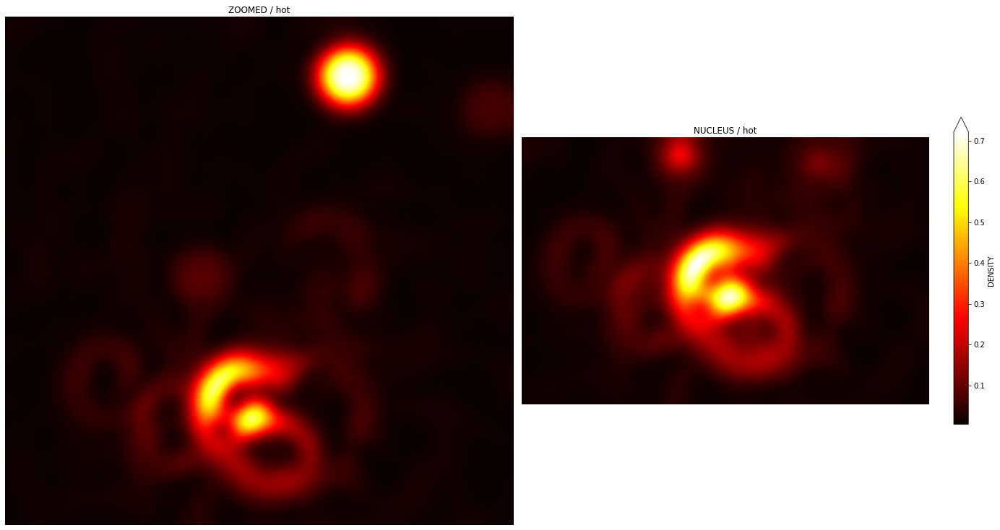

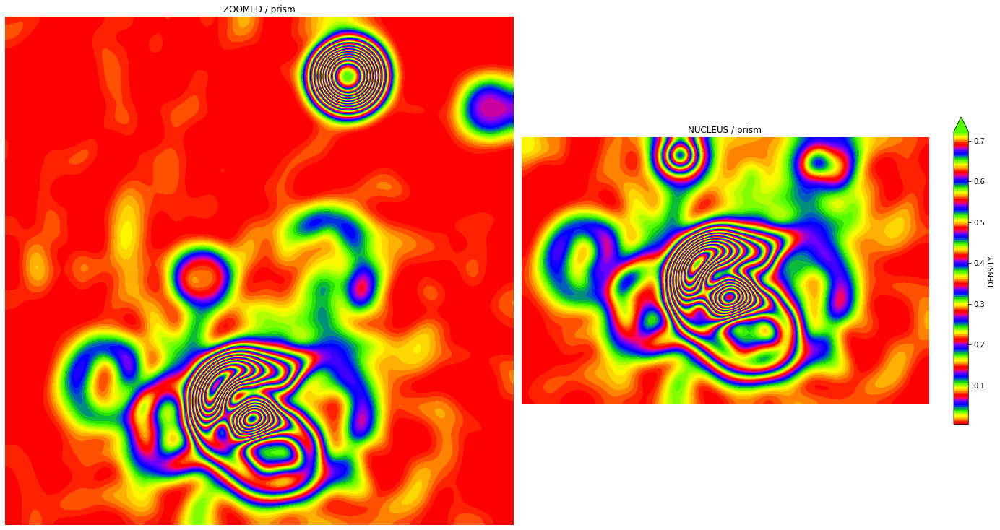

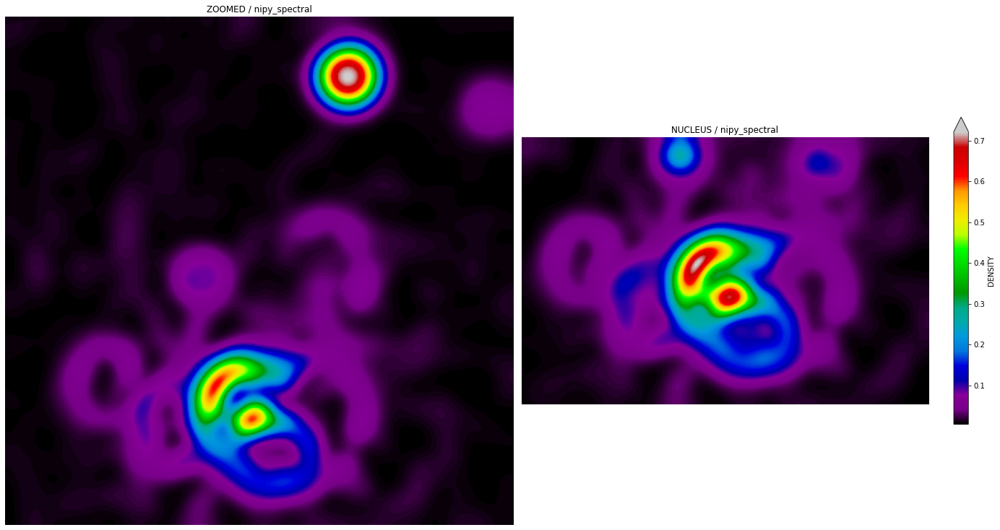

...

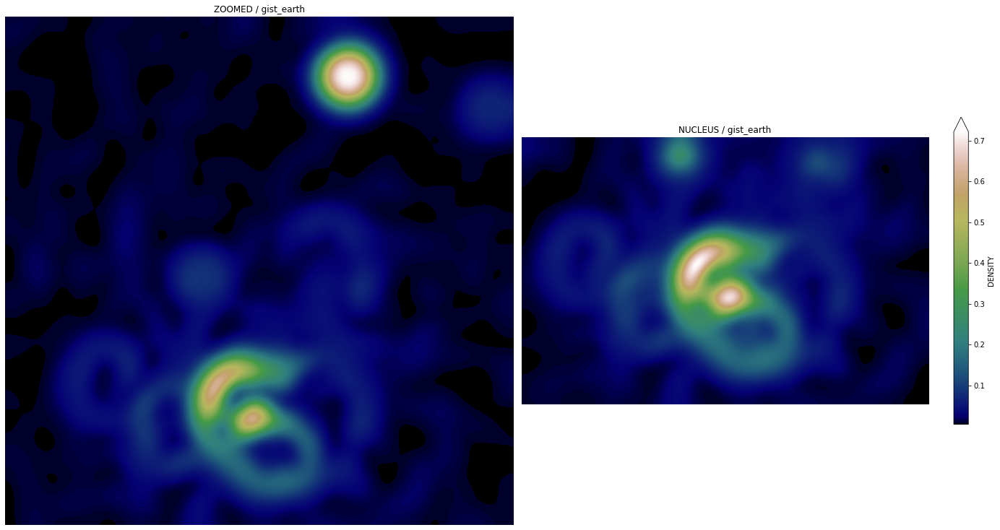

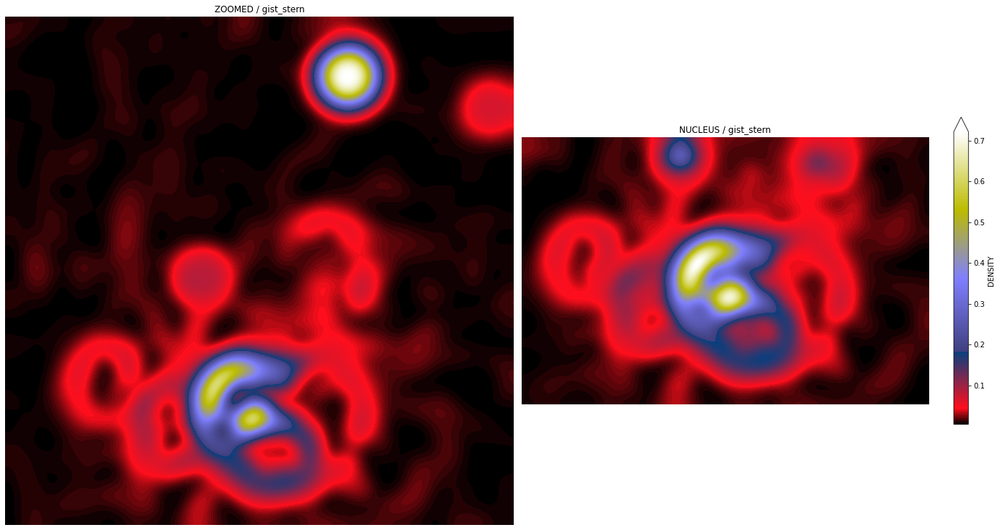

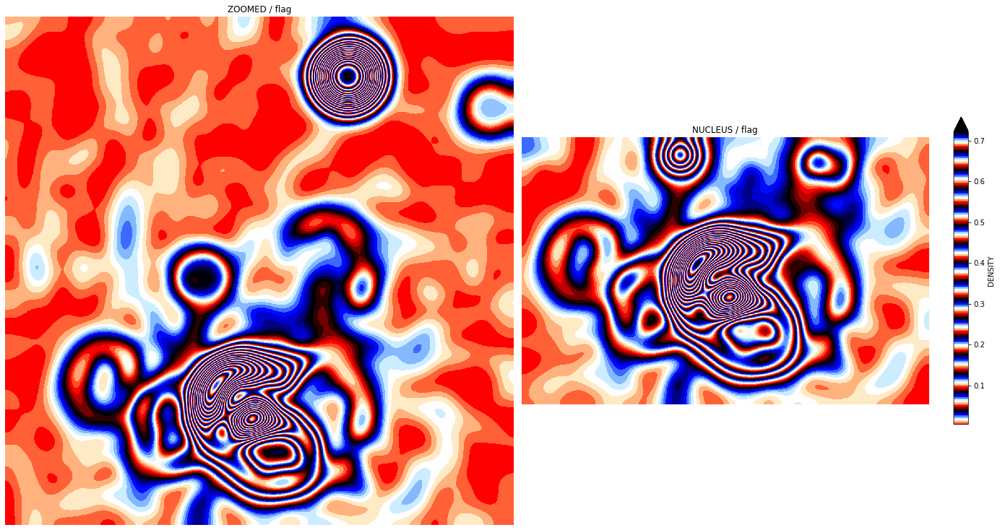

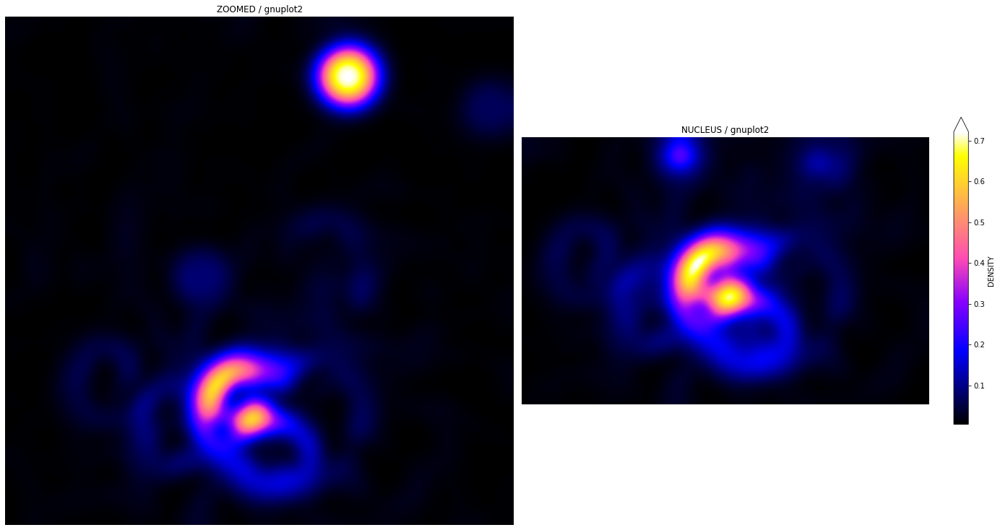

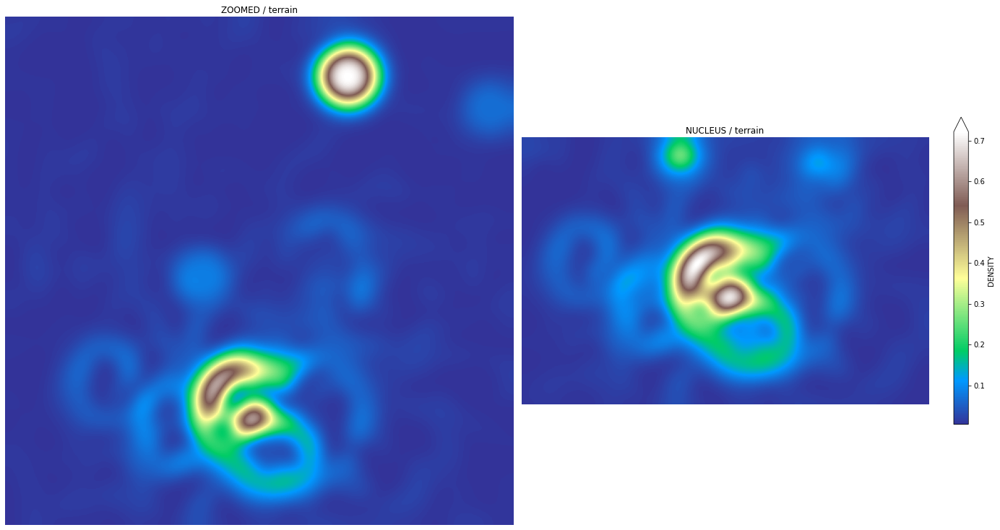

In [62]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(M_GAUSS_ZOOMED_X2,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(M_GAUSS_NUCLEUS,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

In [63]:
BM_GAUSS_ZOOMED_X2 = gaussian_filter(BM_ZOOMED_X3_SCALE_HST,sigma=5)
BM_GAUSS_NUCLEUS = gaussian_filter(BM_NUCLEUS_SCALE_HST,sigma=5)

# **FEATURE DETECTION** 

**CLAHE Histogram Equalization – OpenCV**
Contrast Limited Adaptive Histogram Equalization (CLAHE) to equalize images. CLAHE is a variant of Adaptive histogram equalization (AHE) which takes care of over-amplification of the contrast. CLAHE operates on small regions in the image, called tiles, rather than the entire image. The neighboring tiles are then combined using bilinear interpolation to remove the artificial boundaries. 
This algorithm can be applied to improve the contrast of images.
We can also apply CLAHE to color images, where usually it is applied on the luminance channel and the results after equalizing only the luminance channel of an HSV image are much better than equalizing all the channels of the BGR image. 
In this tutorial, we are going to learn how to apply CLAHE and process a given input image for histogram equalization.

In [65]:
Clahe_Func = cv2.createCLAHE(clipLimit=5.0,tileGridSize=(3,3))

In [66]:
CLAHE_ZOOMED_X2 = Clahe_Func.apply(ZOOMED_X3_SCALE_HST.astype(np.uint8))
CLAHE_NUCLEUS_CLAHE = Clahe_Func.apply(NUCLEUS_SCALE_HST.astype(np.uint8))

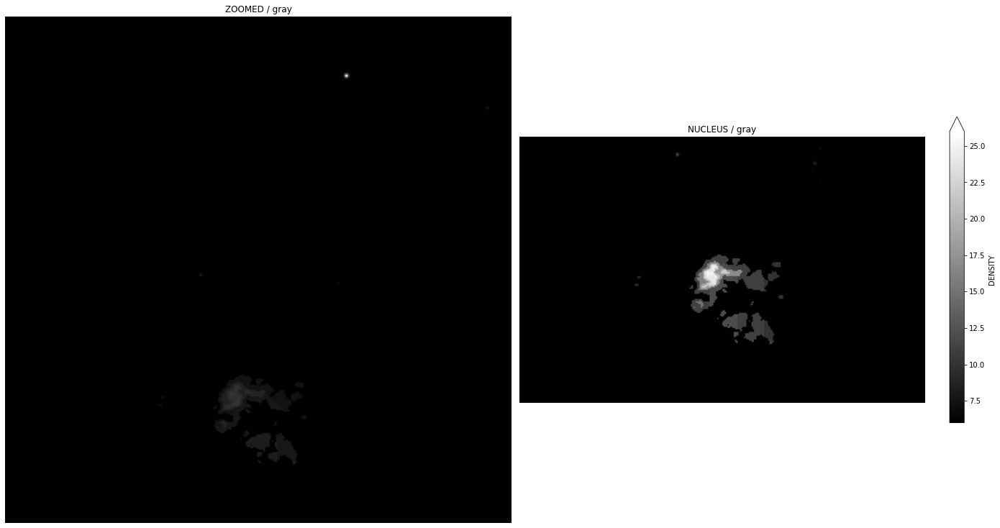

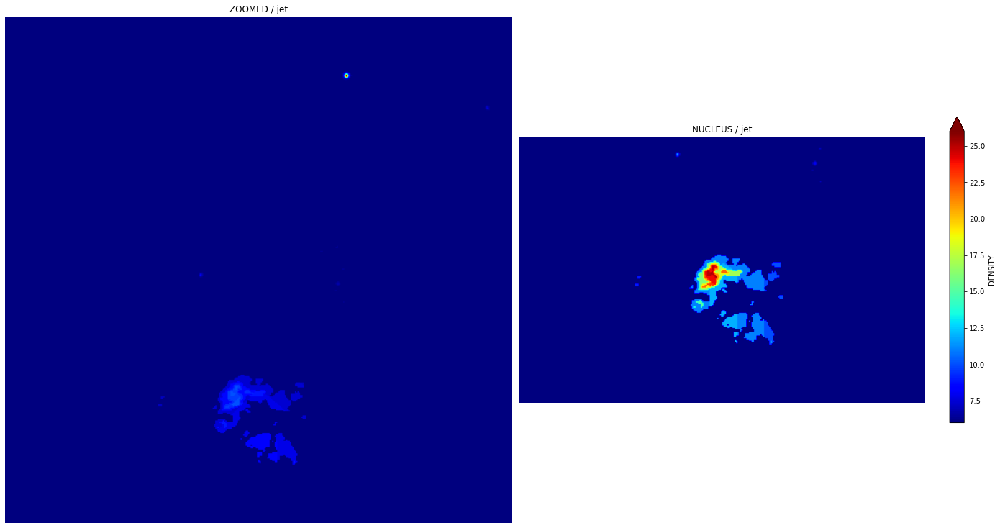

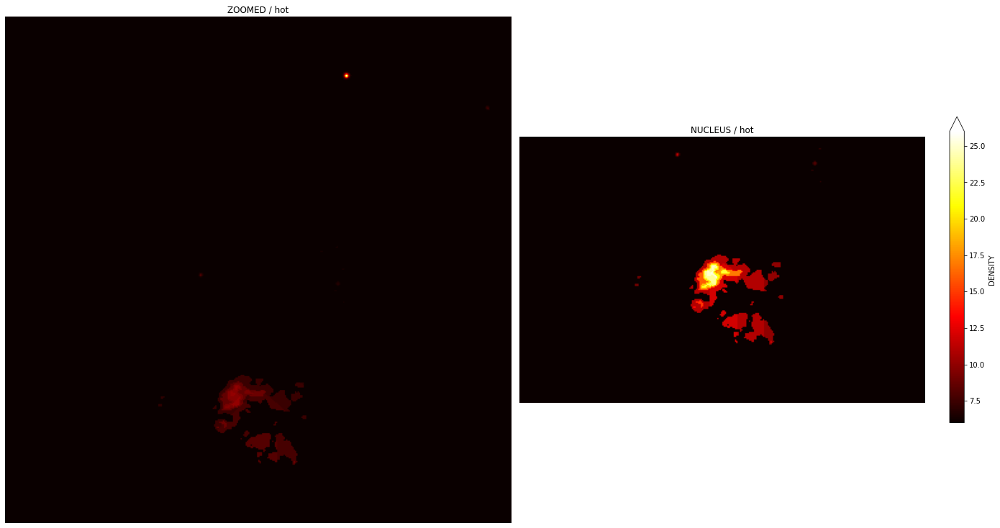

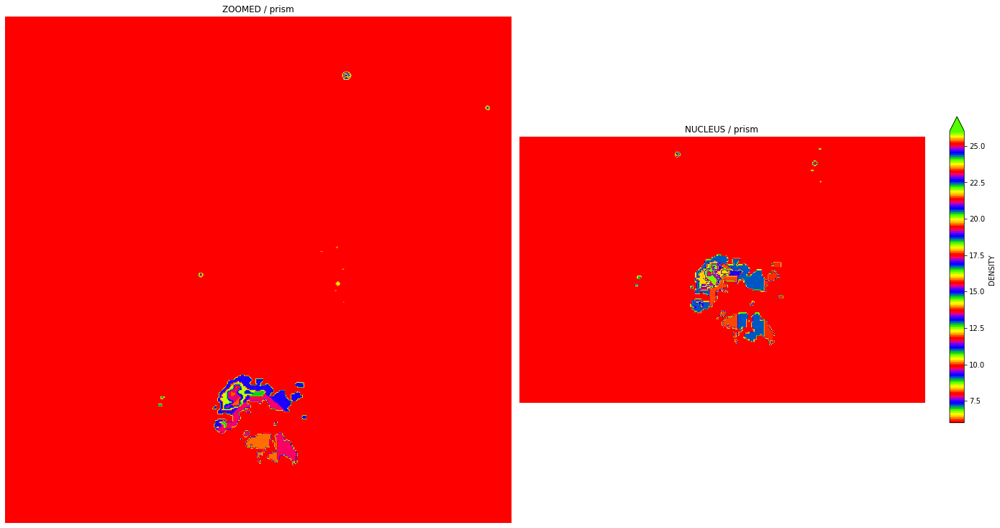

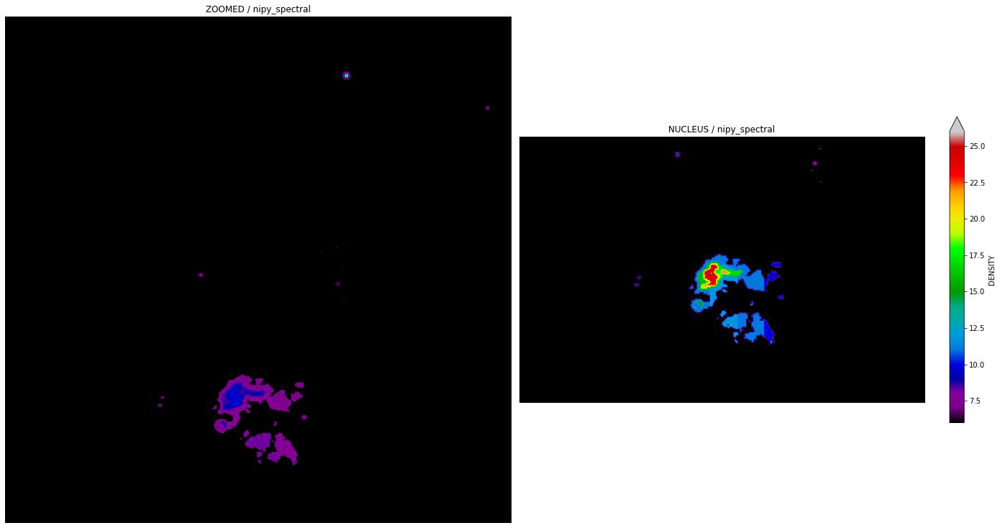

...

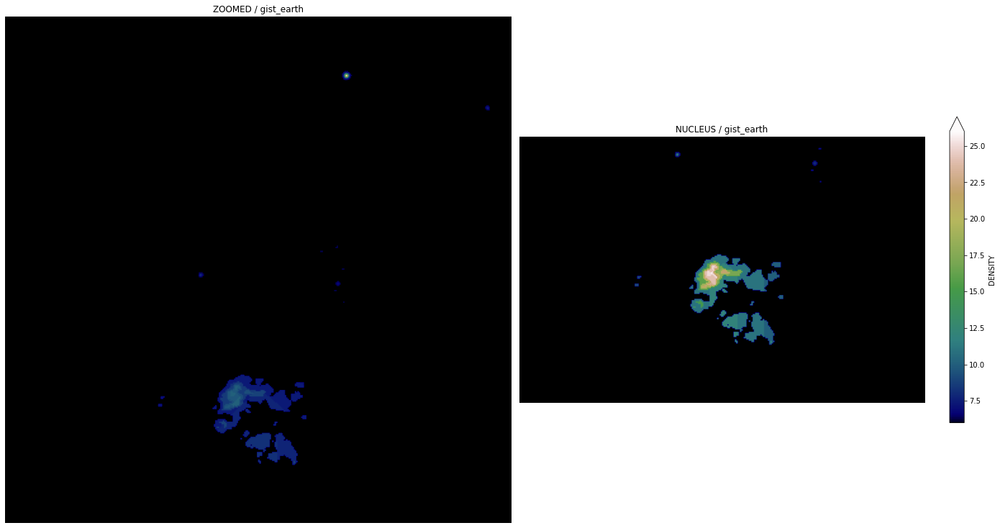

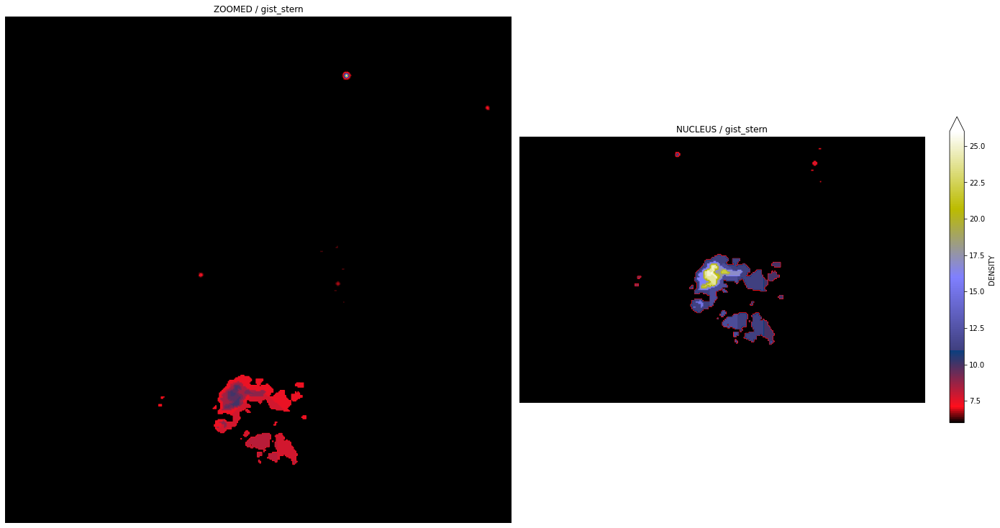

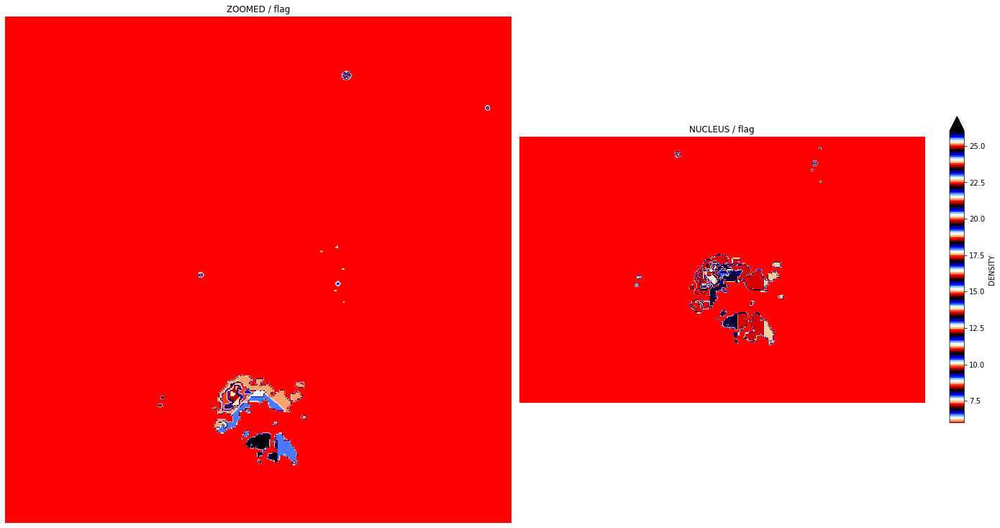

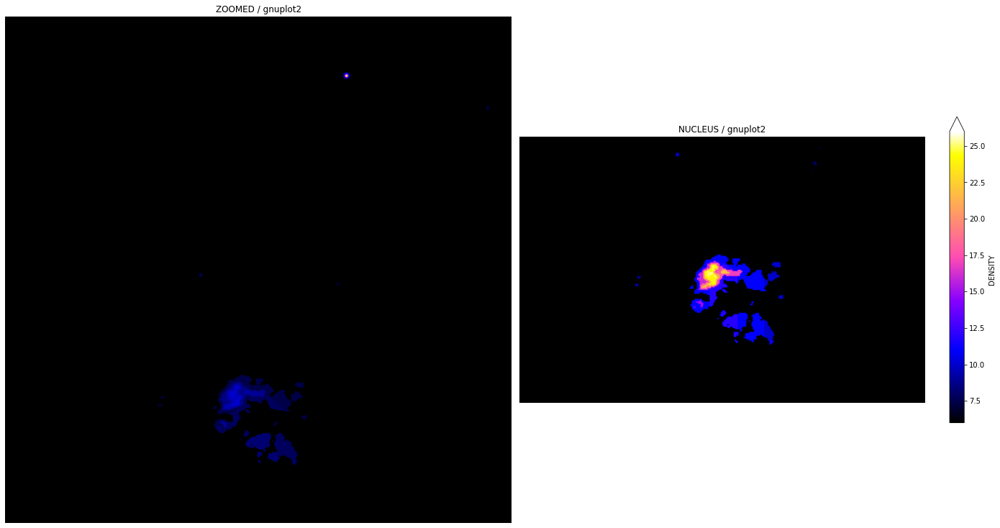

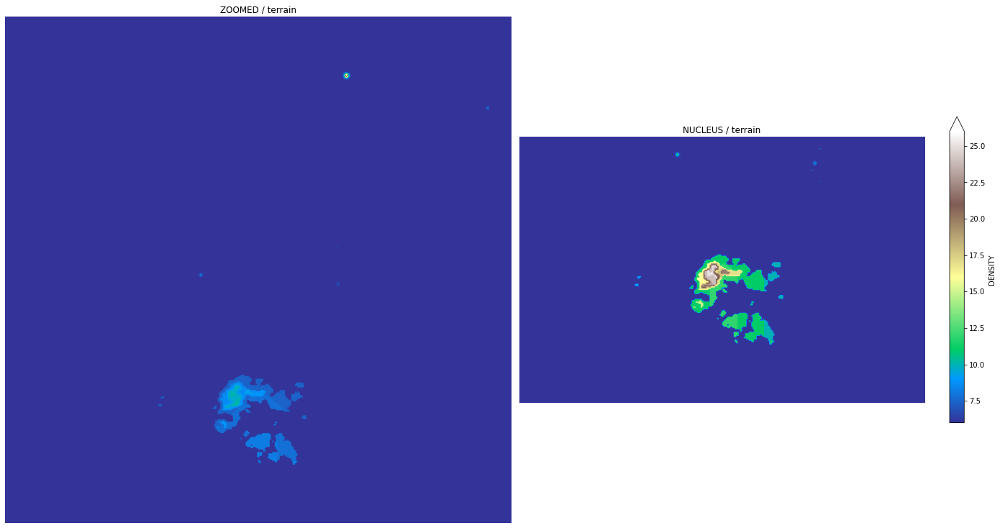

In [67]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(CLAHE_ZOOMED_X2,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(CLAHE_NUCLEUS_CLAHE,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

In [68]:
data = ZOOMED_X3_SCALE_HST.flatten()

In [69]:
data

array([0.14134736, 0.22257417, 0.3537239 , ..., 0.11241787, 0.11014394,
       0.10772523], dtype=float32)

**Specgram** : 
The specgram() function in pyplot module of matplotlib library is used to plot a spectrogram. A spectrogram is a visual representation of the spectrum of frequencies of a signal as it varies with time. When applied to an audio signal, spectrograms are sometimes called sonographs, voiceprints, or voicegrams. When the data are represented in a 3D plot they may be called waterfall displays.

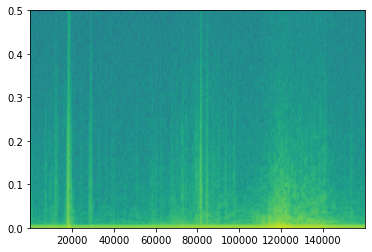

In [70]:
powerSpectrum_1, freqenciesFound_1, time_1, imageAxis_1=plt.specgram(data,Fs = 1)

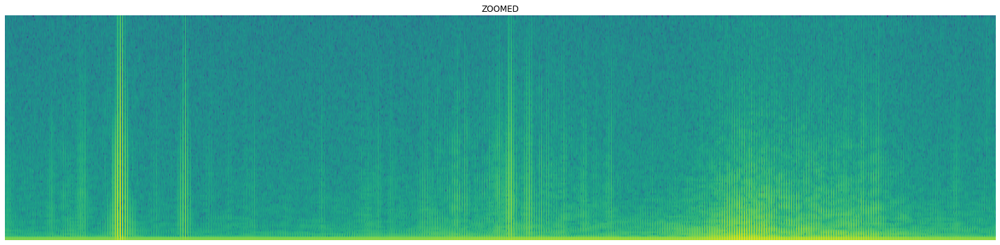

In [71]:
figure = plt.figure(figsize=(20,5))
powerSpectrum_1, freqenciesFound_1, time_1, imageAxis_1 = plt.specgram(ZOOMED_X3_SCALE_HST.flatten(),Fs = 1)
plt.axis("off")
plt.title("ZOOMED")
plt.tight_layout()
plt.show()

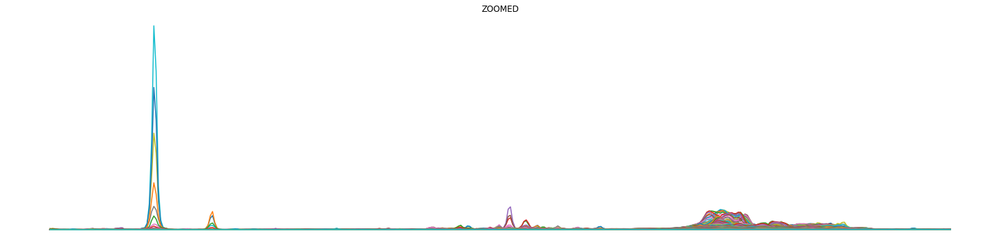

In [73]:
figure = plt.figure(figsize=(20,5))
plt.axis("off")
plt.title("ZOOMED")
plt.tight_layout()
plt.plot(ZOOMED_X3_SCALE_HST)
plt.show()

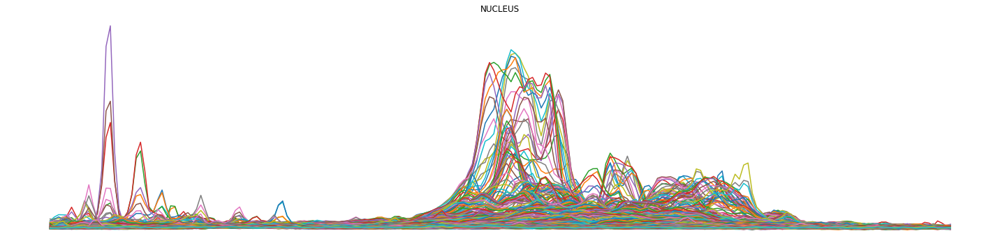

In [74]:
figure = plt.figure(figsize=(20,5))
plt.axis("off")
plt.title("NUCLEUS")
plt.tight_layout()
plt.plot(NUCLEUS_SCALE_HST)
plt.show()

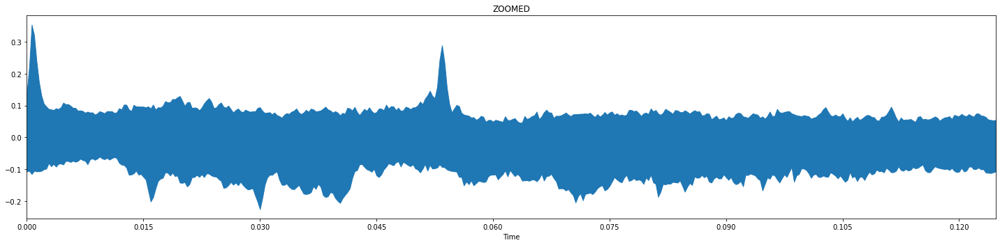

In [75]:

figure = plt.figure(figsize=(20,5))

librosa.display.waveplot(ZOOMED_X3_SCALE_HST.astype(np.float32),sr=3200)
plt.title("ZOOMED")
plt.tight_layout()
plt.show()

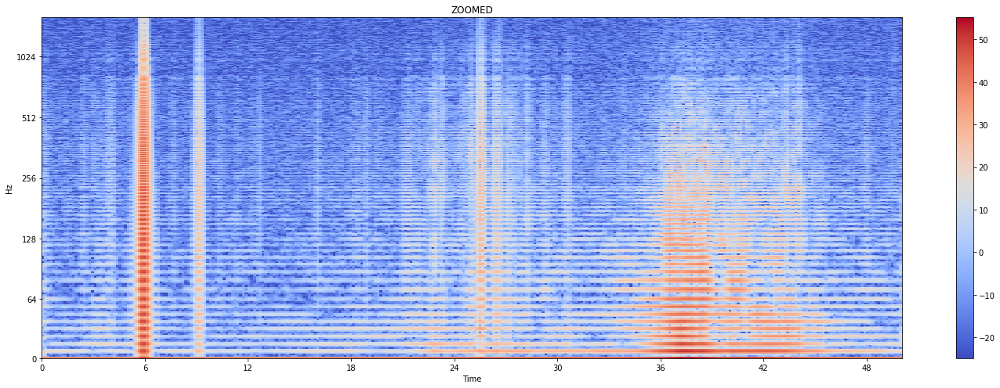

In [77]:
figure = plt.figure(figsize=(20,7))
ZOOMED_X = librosa.stft(ZOOMED_X3_SCALE_HST.flatten().astype(np.float32))
ZOOMED_XDB = librosa.amplitude_to_db(abs(ZOOMED_X))
librosa.display.specshow(ZOOMED_XDB, sr=3200, x_axis='time', y_axis='log')
plt.colorbar()
plt.title("ZOOMED")
plt.tight_layout()
plt.show()

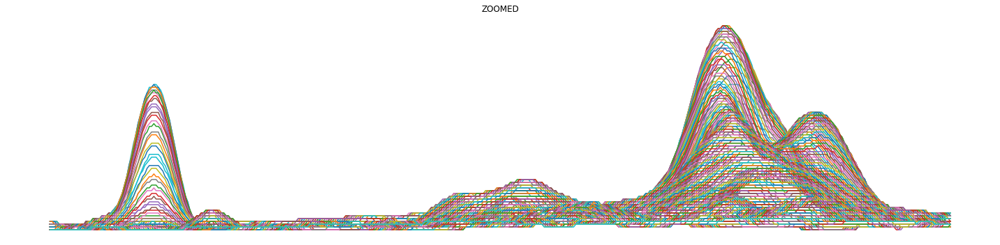

In [81]:
figure = plt.figure(figsize=(20,5))
plt.axis("off")
plt.title("ZOOMED")
plt.tight_layout()
plt.plot(ZOOM_3D[:,:,0])
plt.show()